# Model setup

In [1]:
import numpy as np

In [2]:
# Copyright (c) Facebook, Inc. and its affiliates.
# All rights reserved.
#
# This source code is licensed under the license found in the
# LICENSE file in the root directory of this source tree.

import errno
import functools
import hashlib
import inspect
import io
import os
import random
import socket
import tempfile
import warnings
import zlib
from contextlib import contextmanager

from diffq import UniformQuantizer, DiffQuantizer
import torch as th
import tqdm
from torch import distributed
from torch.nn import functional as F


def center_trim(tensor, reference):
    """
    Center trim `tensor` with respect to `reference`, along the last dimension.
    `reference` can also be a number, representing the length to trim to.
    If the size difference != 0 mod 2, the extra sample is removed on the right side.
    """
    if hasattr(reference, "size"):
        reference = reference.size(-1)
    delta = tensor.size(-1) - reference
    if delta < 0:
        raise ValueError("tensor must be larger than reference. " f"Delta is {delta}.")
    if delta:
        tensor = tensor[..., delta // 2:-(delta - delta // 2)]
    return tensor


def average_metric(metric, count=1.):
    """
    Average `metric` which should be a float across all hosts. `count` should be
    the weight for this particular host (i.e. number of examples).
    """
    metric = th.tensor([count, count * metric], dtype=th.float32, device='cuda')
    distributed.all_reduce(metric, op=distributed.ReduceOp.SUM)
    return metric[1].item() / metric[0].item()


def free_port(host='', low=20000, high=40000):
    """
    Return a port number that is most likely free.
    This could suffer from a race condition although
    it should be quite rare.
    """
    sock = socket.socket()
    while True:
        port = random.randint(low, high)
        try:
            sock.bind((host, port))
        except OSError as error:
            if error.errno == errno.EADDRINUSE:
                continue
            raise
        return port


def sizeof_fmt(num, suffix='B'):
    """
    Given `num` bytes, return human readable size.
    Taken from https://stackoverflow.com/a/1094933
    """
    for unit in ['', 'Ki', 'Mi', 'Gi', 'Ti', 'Pi', 'Ei', 'Zi']:
        if abs(num) < 1024.0:
            return "%3.1f%s%s" % (num, unit, suffix)
        num /= 1024.0
    return "%.1f%s%s" % (num, 'Yi', suffix)


def human_seconds(seconds, display='.2f'):
    """
    Given `seconds` seconds, return human readable duration.
    """
    value = seconds * 1e6
    ratios = [1e3, 1e3, 60, 60, 24]
    names = ['us', 'ms', 's', 'min', 'hrs', 'days']
    last = names.pop(0)
    for name, ratio in zip(names, ratios):
        if value / ratio < 0.3:
            break
        value /= ratio
        last = name
    return f"{format(value, display)} {last}"


class TensorChunk:
    def __init__(self, tensor, offset=0, length=None):
        total_length = tensor.shape[-1]
        assert offset >= 0
        assert offset < total_length

        if length is None:
            length = total_length - offset
        else:
            length = min(total_length - offset, length)

        self.tensor = tensor
        self.offset = offset
        self.length = length
        self.device = tensor.device

    @property
    def shape(self):
        shape = list(self.tensor.shape)
        shape[-1] = self.length
        return shape

    def padded(self, target_length):
        delta = target_length - self.length
        total_length = self.tensor.shape[-1]
        assert delta >= 0

        start = self.offset - delta // 2
        end = start + target_length

        correct_start = max(0, start)
        correct_end = min(total_length, end)

        pad_left = correct_start - start
        pad_right = end - correct_end

        out = F.pad(self.tensor[..., correct_start:correct_end], (pad_left, pad_right))
        assert out.shape[-1] == target_length
        return out


def tensor_chunk(tensor_or_chunk):
    if isinstance(tensor_or_chunk, TensorChunk):
        return tensor_or_chunk
    else:
        assert isinstance(tensor_or_chunk, th.Tensor)
        return TensorChunk(tensor_or_chunk)


def apply_model(model, mix, shifts=None, split=False,
                overlap=0.25, transition_power=1., progress=False):
    """
    Apply model to a given mixture.

    Args:
        shifts (int): if > 0, will shift in time `mix` by a random amount between 0 and 0.5 sec
            and apply the oppositve shift to the output. This is repeated `shifts` time and
            all predictions are averaged. This effectively makes the model time equivariant
            and improves SDR by up to 0.2 points.
        split (bool): if True, the input will be broken down in 8 seconds extracts
            and predictions will be performed individually on each and concatenated.
            Useful for model with large memory footprint like Tasnet.
        progress (bool): if True, show a progress bar (requires split=True)
    """
    assert transition_power >= 1, "transition_power < 1 leads to weird behavior."
    device = mix.device
    channels, length = mix.shape
    if split:
        out = th.zeros(len(model.sources), channels, length, device=device)
        sum_weight = th.zeros(length, device=device)
        segment = model.segment_length
        stride = int((1 - overlap) * segment)
        offsets = range(0, length, stride)
        scale = stride / model.samplerate
        if progress:
            offsets = tqdm.tqdm(offsets, unit_scale=scale, ncols=120, unit='seconds')
        # We start from a triangle shaped weight, with maximal weight in the middle
        # of the segment. Then we normalize and take to the power `transition_power`.
        # Large values of transition power will lead to sharper transitions.
        weight = th.cat([th.arange(1, segment // 2 + 1),
                         th.arange(segment - segment // 2, 0, -1)]).to(device)
        assert len(weight) == segment
        # If the overlap < 50%, this will translate to linear transition when
        # transition_power is 1.
        weight = (weight / weight.max())**transition_power
        for offset in offsets:
            chunk = TensorChunk(mix, offset, segment)
            chunk_out = apply_model(model, chunk, shifts=shifts)
            chunk_length = chunk_out.shape[-1]
            out[..., offset:offset + segment] += weight[:chunk_length] * chunk_out
            sum_weight[offset:offset + segment] += weight[:chunk_length]
            offset += segment
        assert sum_weight.min() > 0
        out /= sum_weight
        return out
    elif shifts:
        max_shift = int(0.5 * model.samplerate)
        mix = tensor_chunk(mix)
        padded_mix = mix.padded(length + 2 * max_shift)
        out = 0
        for _ in range(shifts):
            offset = random.randint(0, max_shift)
            shifted = TensorChunk(padded_mix, offset, length + max_shift - offset)
            shifted_out = apply_model(model, shifted)
            out += shifted_out[..., max_shift - offset:]
        out /= shifts
        return out
    else:
        valid_length = model.valid_length(length)
        mix = tensor_chunk(mix)
        padded_mix = mix.padded(valid_length)
        with th.no_grad():
            out = model(padded_mix.unsqueeze(0))[0]
        return center_trim(out, length)


@contextmanager
def temp_filenames(count, delete=True):
    names = []
    try:
        for _ in range(count):
            names.append(tempfile.NamedTemporaryFile(delete=False).name)
        yield names
    finally:
        if delete:
            for name in names:
                os.unlink(name)


def get_quantizer(model, args, optimizer=None):
    quantizer = None
    if args.diffq:
        quantizer = DiffQuantizer(
            model, min_size=args.q_min_size, group_size=8)
        if optimizer is not None:
            quantizer.setup_optimizer(optimizer)
    elif args.qat:
        quantizer = UniformQuantizer(
                model, bits=args.qat, min_size=args.q_min_size)
    return quantizer


def load_model(path, strict=False):
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        load_from = path
        package = th.load(load_from, 'cpu')

    klass = package["klass"]
    args = package["args"]
    kwargs = package["kwargs"]

    if strict:
        model = klass(*args, **kwargs)
    else:
        sig = inspect.signature(klass)
        for key in list(kwargs):
            if key not in sig.parameters:
                warnings.warn("Dropping inexistant parameter " + key)
                del kwargs[key]
        model = klass(*args, **kwargs)

    state = package["state"]
    training_args = package["training_args"]
    quantizer = get_quantizer(model, training_args)

    set_state(model, quantizer, state)
    return model


def get_state(model, quantizer, half=False):
    if quantizer is None:
        dtype = th.half if half else None
        state = {k: p.data.to(device='cpu', dtype=dtype) for k, p in model.state_dict().items()}
    else:
        state = quantizer.get_quantized_state()
        buf = io.BytesIO()
        th.save(state, buf)
        state = {'compressed': zlib.compress(buf.getvalue())}
    return state


def set_state(model, quantizer, state):
    if quantizer is None:
        model.load_state_dict(state)
    else:
        buf = io.BytesIO(zlib.decompress(state["compressed"]))
        state = th.load(buf, "cpu")
        quantizer.restore_quantized_state(state)

    return state


def save_state(state, path):
    buf = io.BytesIO()
    th.save(state, buf)
    sig = hashlib.sha256(buf.getvalue()).hexdigest()[:8]

    path = path.parent / (path.stem + "-" + sig + path.suffix)
    path.write_bytes(buf.getvalue())


def save_model(model, quantizer, training_args, path):
    args, kwargs = model._init_args_kwargs
    klass = model.__class__

    state = get_state(model, quantizer, half=training_args.half)

    save_to = path
    package = {
        'klass': klass,
        'args': args,
        'kwargs': kwargs,
        'state': state,
        'training_args': training_args,
    }
    th.save(package, save_to)


def capture_init(init):
    @functools.wraps(init)
    def __init__(self, *args, **kwargs):
        self._init_args_kwargs = (args, kwargs)
        init(self, *args, **kwargs)

    return __init__

C:\Users\leo\.conda\envs\myenv\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# Copyright (c) Facebook, Inc. and its affiliates.
# All rights reserved.
#
# This source code is licensed under the license found in the
# LICENSE file in the root directory of this source tree.

import math

import julius
from torch import nn

#from .utils import capture_init, center_trim


class BLSTM(nn.Module):
    def __init__(self, dim, layers=1):
        super().__init__()
        self.lstm = nn.LSTM(bidirectional=True, num_layers=layers, hidden_size=dim, input_size=dim)
        self.linear = nn.Linear(2 * dim, dim)

    def forward(self, x):
        x = x.permute(2, 0, 1)
        x = self.lstm(x)[0]
        x = self.linear(x)
        x = x.permute(1, 2, 0)
        return x


def rescale_conv(conv, reference):
    std = conv.weight.std().detach()
    scale = (std / reference)**0.5
    conv.weight.data /= scale
    if conv.bias is not None:
        conv.bias.data /= scale


def rescale_module(module, reference):
    for sub in module.modules():
        if isinstance(sub, (nn.Conv1d, nn.ConvTranspose1d)):
            rescale_conv(sub, reference)


class Demucs(nn.Module):
    @capture_init
    def __init__(self,
                 sources,
                 audio_channels=2,
                 channels=64,
                 depth=6,
                 rewrite=True,
                 glu=True,
                 rescale=0.1,
                 resample=True,
                 kernel_size=8,
                 stride=4,
                 growth=2.,
                 lstm_layers=2,
                 context=3,
                 normalize=False,
                 samplerate=44100,
                 segment_length=4 * 10 * 44100):
        """
        Args:
            sources (list[str]): list of source names
            audio_channels (int): stereo or mono
            channels (int): first convolution channels
            depth (int): number of encoder/decoder layers
            rewrite (bool): add 1x1 convolution to each encoder layer
                and a convolution to each decoder layer.
                For the decoder layer, `context` gives the kernel size.
            glu (bool): use glu instead of ReLU
            resample_input (bool): upsample x2 the input and downsample /2 the output.
            rescale (int): rescale initial weights of convolutions
                to get their standard deviation closer to `rescale`
            kernel_size (int): kernel size for convolutions
            stride (int): stride for convolutions
            growth (float): multiply (resp divide) number of channels by that
                for each layer of the encoder (resp decoder)
            lstm_layers (int): number of lstm layers, 0 = no lstm
            context (int): kernel size of the convolution in the
                decoder before the transposed convolution. If > 1,
                will provide some context from neighboring time
                steps.
            samplerate (int): stored as meta information for easing
                future evaluations of the model.
            segment_length (int): stored as meta information for easing
                future evaluations of the model. Length of the segments on which
                the model was trained.
        """

        super().__init__()
        self.audio_channels = audio_channels
        self.sources = sources
        self.kernel_size = kernel_size
        self.context = context
        self.stride = stride
        self.depth = depth
        self.resample = resample
        self.channels = channels
        self.normalize = normalize
        self.samplerate = samplerate
        self.segment_length = segment_length

        self.encoder = nn.ModuleList()
        self.decoder = nn.ModuleList()

        if glu:
            activation = nn.GLU(dim=1)
            ch_scale = 2
        else:
            activation = nn.ReLU()
            ch_scale = 1
        in_channels = audio_channels
        for index in range(depth):
            encode = []
            encode += [nn.Conv1d(in_channels, channels, kernel_size, stride), nn.ReLU()]
            if rewrite:
                encode += [nn.Conv1d(channels, ch_scale * channels, 1), activation]
            self.encoder.append(nn.Sequential(*encode))

            decode = []
            if index > 0:
                out_channels = in_channels
            else:
                #out_channels = len(self.sources) * audio_channels
                out_channels = 1
            if rewrite:
                decode += [nn.Conv1d(channels, ch_scale * channels, context), activation]
            decode += [nn.ConvTranspose1d(channels, out_channels, kernel_size, stride)]
            if index > 0:
                decode.append(nn.ReLU())
            self.decoder.insert(0, nn.Sequential(*decode))
            in_channels = channels
            channels = int(growth * channels)

        channels = in_channels

        if lstm_layers:
            self.lstm = BLSTM(channels, lstm_layers)
        else:
            self.lstm = None

        if rescale:
            rescale_module(self, reference=rescale)

    def valid_length(self, length):
        """
        Return the nearest valid length to use with the model so that
        there is no time steps left over in a convolutions, e.g. for all
        layers, size of the input - kernel_size % stride = 0.

        If the mixture has a valid length, the estimated sources
        will have exactly the same length when context = 1. If context > 1,
        the two signals can be center trimmed to match.

        For training, extracts should have a valid length.For evaluation
        on full tracks we recommend passing `pad = True` to :method:`forward`.
        """
        if self.resample:
            length *= 2
        for _ in range(self.depth):
            length = math.ceil((length - self.kernel_size) / self.stride) + 1
            length = max(1, length)
            length += self.context - 1
        for _ in range(self.depth):
            length = (length - 1) * self.stride + self.kernel_size

        if self.resample:
            length = math.ceil(length / 2)
        return int(length)

    def forward(self, mix):
        x = mix

        if self.normalize:
            mono = mix.mean(dim=1, keepdim=True)
            mean = mono.mean(dim=-1, keepdim=True)
            std = mono.std(dim=-1, keepdim=True)
        else:
            mean = 0
            std = 1

        x = (x - mean) / (1e-5 + std)

        if self.resample:
            x = julius.resample_frac(x, 1, 2)

        saved = []
        for encode in self.encoder:
            x = encode(x)
            saved.append(x)
        if self.lstm:
            x = self.lstm(x)
        for decode in self.decoder:
            skip = center_trim(saved.pop(-1), x)
            x = x + skip
            x = decode(x)

        if self.resample:
            x = julius.resample_frac(x, 2, 1)
        x = x * std + mean
        #x = x.view(x.size(0), len(self.sources), self.audio_channels, x.size(-1))
        return x

In [4]:
model = Demucs(['bass'], audio_channels=15,depth=4,kernel_size=10,lstm_layers=0,resample=False,stride=2)

In [5]:
print(model)

Demucs(
  (encoder): ModuleList(
    (0): Sequential(
      (0): Conv1d(15, 64, kernel_size=(10,), stride=(2,))
      (1): ReLU()
      (2): Conv1d(64, 128, kernel_size=(1,), stride=(1,))
      (3): GLU(dim=1)
    )
    (1): Sequential(
      (0): Conv1d(64, 128, kernel_size=(10,), stride=(2,))
      (1): ReLU()
      (2): Conv1d(128, 256, kernel_size=(1,), stride=(1,))
      (3): GLU(dim=1)
    )
    (2): Sequential(
      (0): Conv1d(128, 256, kernel_size=(10,), stride=(2,))
      (1): ReLU()
      (2): Conv1d(256, 512, kernel_size=(1,), stride=(1,))
      (3): GLU(dim=1)
    )
    (3): Sequential(
      (0): Conv1d(256, 512, kernel_size=(10,), stride=(2,))
      (1): ReLU()
      (2): Conv1d(512, 1024, kernel_size=(1,), stride=(1,))
      (3): GLU(dim=1)
    )
  )
  (decoder): ModuleList(
    (0): Sequential(
      (0): Conv1d(512, 1024, kernel_size=(3,), stride=(1,))
      (1): GLU(dim=1)
      (2): ConvTranspose1d(512, 256, kernel_size=(10,), stride=(2,))
      (3): ReLU()
    )
 

In [6]:
from torch.utils.data import TensorDataset, DataLoader

In [7]:
from torch.utils.data import Dataset

In [8]:
import sys
import matplotlib.pyplot as plt

In [9]:
optimizer = th.optim.Adam(model.parameters(), lr=3e-4)

In [10]:
criterion = nn.MSELoss()

In [11]:
lam = 0
omlam = 1

In [12]:
def train_model(epoch,
                dataset,
                model,
                criterion,
                optimizer,
                augment,
                quantizer=None,
                diffq=0,
                repeat=1,
                device="cpu",
                seed=None,
                workers=1,
                world_size=1,
                batch_size=1):

    loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
    #print("loader create complete")
    current_loss = 0
    model_size = 0
    for repetition in range(repeat):
        tq = tqdm.tqdm(loader,
                       ncols=120,
                       desc=f"[{epoch:03d}] train ({repetition + 1}/{repeat})",
                       unit=" batch")
        total_loss = 0
        #print("tq create complete")
        for idx, [x, y] in enumerate(tq):
            #print(x.shape)
            #print(y.shape)
            optimizer.zero_grad()

            x = x.to(device)
            y = y.to(device)
            estimates = model(x)
            #print(estimates.shape[-1])
            y = center_trim(y, estimates)
            #fftest=th.fft.rfft(estimates)
            #fftgt=th.fft.rfft(y)
            #fftloss = (criterion(fftest.real, fftgt.real)+criterion(fftest.imag, fftgt.imag))*2/estimates.shape[-1]*lam
            waveloss = criterion(estimates, y)
            
            #fftloss.backward(retain_graph=True)
            waveloss.backward()
            train_loss = waveloss
            grad_norm = 0
            for p in model.parameters():
                if p.grad is not None:
                    grad_norm += p.grad.data.norm()**2
            grad_norm = grad_norm**0.5
            optimizer.step()

            if quantizer is not None:
                model_size = model_size.item()

            total_loss += train_loss.item()
            current_loss = total_loss / (1 + idx)
            #writer.add_scalar('fftLoss/train', fftloss.item())
            writer.add_scalar('waveLoss/train', waveloss.item())
            writer.add_scalar('totalLoss/train', train_loss.item())
            tq.set_postfix(loss=f"{current_loss:.4f}", ms=f"{model_size:.2f}",
                           grad=f"{grad_norm:.5f}")

            # free some space before next round
            del x ,y ,estimates, train_loss

        if world_size > 1:
            sampler.epoch += 1

    if world_size > 1:
        current_loss = average_metric(current_loss)
    return current_loss, model_size

In [13]:
import plotly.graph_objects as go

In [14]:
import matplotlib

# Dataset loader setup

In [15]:
class cohfaceDataset(Dataset):
    def __init__(self, path, randomclip = True, filterx = True):
        self.path = path
        self.filelist = os.listdir(path)
        self.randomclip = randomclip
        self.gt = np.load('normalized_label22_morefilt.npy')
        self.filterx = filterx
        
    def __getitem__(self, index):
        fname=self.filelist[index]
        x = np.load(self.path+fname)
        personid = int(fname[1:3])- 1
        expid = int(fname[9:11])- 1
        y = self.gt[personid,expid]
        #y = y/y.std()
        
        #interpolating y
        yinterp = np.interp(np.arange(len(x))*(len(y)/len(x)), np.arange(len(y)), y)
        #rgb to hsv
        #x = matplotlib.colors.rgb_to_hsv(x/255)
        #x = x*255
        #normalize data
        if self.filterx:
            '''
            if x.shape[0] == 2999:
                print(fname)
            x[:,0] = filt(x[:,0])
            x[:,1] = filt(x[:,1])
            x[:,2] = filt(x[:,2])
            x[:,3] = filt(x[:,3])
            x[:,4] = filt(x[:,4])
            x[:,5] = filt(x[:,5])
            '''
            x = x - x.mean(axis=0)
            
        #x = th.tensor(x).float()
        
        #crop data
        x=x[375:-375]
        yinterp=yinterp[375:-375]
        
        if self.randomclip:
            augsize = np.random.randint(800,len(x)-20) 
            augstart = np.random.randint(0,len(x) - augsize) 
            augend = augstart+augsize
            x = x[augstart:augend]
            yinterp = yinterp[augstart:augend]
            orilen = len(yinterp)
            newlen = int(len(x)*(0.7+0.6*(np.random.rand())))
            #print(orilen)
            #print(newlen)
            yinterp = np.interp(np.arange(newlen)*(orilen/newlen), np.arange(orilen), yinterp)
            intepx = np.zeros((newlen,6))
            intepx[:,0] = np.interp(np.arange(newlen)*(orilen/newlen), np.arange(orilen), x[:,0])
            intepx[:,1] = np.interp(np.arange(newlen)*(orilen/newlen), np.arange(orilen), x[:,1])
            intepx[:,2] = np.interp(np.arange(newlen)*(orilen/newlen), np.arange(orilen), x[:,2])
            intepx[:,3] = np.interp(np.arange(newlen)*(orilen/newlen), np.arange(orilen), x[:,3])
            intepx[:,4] = np.interp(np.arange(newlen)*(orilen/newlen), np.arange(orilen), x[:,4])
            intepx[:,5] = np.interp(np.arange(newlen)*(orilen/newlen), np.arange(orilen), x[:,5])
            x=th.tensor(intepx).float()
        else:
            x=th.tensor(x).float()
        x = x.permute(1,0)
        yinterp = th.tensor(yinterp).float()
        yinterp = yinterp.unsqueeze(0)
        return x, yinterp
    
    def __len__(self):
        return len(self.filelist)

In [16]:
train_dataset = cohfaceDataset("deap5ch/training/",randomclip = False)

In [17]:
train_dataset.gt.shape

(22, 40, 8064)

In [18]:
temporx,tempory = train_dataset[0]

In [19]:
temporx.shape

torch.Size([15, 2250])

In [20]:
tempory.shape

torch.Size([1, 2250])

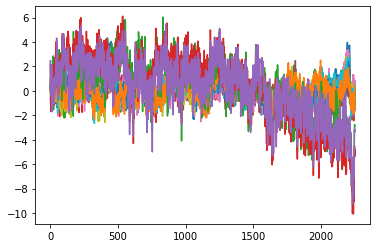

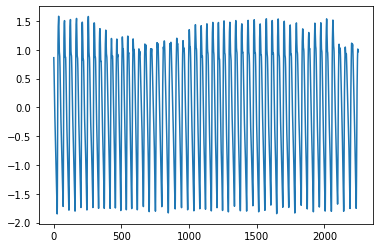

In [21]:
plt.plot(temporx.T)
plt.show()
plt.plot(tempory.T)
plt.show()

In [22]:
th.cuda.is_available()

True

In [23]:
device = th.device("cuda:0" if th.cuda.is_available() else "cpu")
print(device)

cuda:0


In [24]:
model.to(device)

Demucs(
  (encoder): ModuleList(
    (0): Sequential(
      (0): Conv1d(15, 64, kernel_size=(10,), stride=(2,))
      (1): ReLU()
      (2): Conv1d(64, 128, kernel_size=(1,), stride=(1,))
      (3): GLU(dim=1)
    )
    (1): Sequential(
      (0): Conv1d(64, 128, kernel_size=(10,), stride=(2,))
      (1): ReLU()
      (2): Conv1d(128, 256, kernel_size=(1,), stride=(1,))
      (3): GLU(dim=1)
    )
    (2): Sequential(
      (0): Conv1d(128, 256, kernel_size=(10,), stride=(2,))
      (1): ReLU()
      (2): Conv1d(256, 512, kernel_size=(1,), stride=(1,))
      (3): GLU(dim=1)
    )
    (3): Sequential(
      (0): Conv1d(256, 512, kernel_size=(10,), stride=(2,))
      (1): ReLU()
      (2): Conv1d(512, 1024, kernel_size=(1,), stride=(1,))
      (3): GLU(dim=1)
    )
  )
  (decoder): ModuleList(
    (0): Sequential(
      (0): Conv1d(512, 1024, kernel_size=(3,), stride=(1,))
      (1): GLU(dim=1)
      (2): ConvTranspose1d(512, 256, kernel_size=(10,), stride=(2,))
      (3): ReLU()
    )
 

In [25]:
test_dataset = cohfaceDataset("deap5ch/testing/",randomclip = False)

In [26]:
temporx,tempory = test_dataset[-1]

In [27]:
temporx.shape

torch.Size([15, 2250])

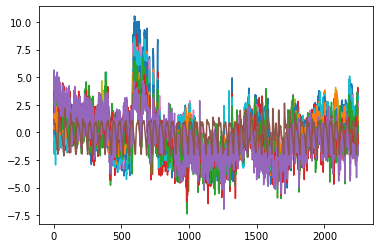

In [28]:
plt.plot(temporx.T)
plt.plot(tempory.T)

# Code for training

In [29]:
from scipy.misc import electrocardiogram
from scipy.signal import find_peaks

In [30]:
#Pulse group convertion
def createg(peaks,data):
    sampnum = 100
    fin = np.zeros((len(peaks)-2,sampnum))
    for i in range(len(peaks)-2):
        tempd = data[peaks[i]:peaks[i+1]+1]
        tinterp = np.interp(np.arange(sampnum)*len(tempd)/sampnum, np.arange(len(tempd)), tempd)
        tinterp = tinterp - np.arange(sampnum)*(tinterp[-1]-tinterp[0])/(sampnum-1)
        tinterp = tinterp - tinterp[0]
        tinterp = tinterp/tinterp.mean()
        fin[i,:] = tinterp
    return fin
def tosignature(dat):
    peaks, _ = find_peaks(-dat, height=0,distance=20)
    '''fig = go.Figure()
    fig.add_trace(go.Scatter(y=dat))
    fig.add_trace(go.Scatter(x=peaks,y=dat[peaks],mode="markers"))
    fig.show()'''
    return peaks
def outlierremove(dat):
    a = np.ma.array(dat, mask=False)
    for i in range(len(dat)):
        a.mask[i] = True
        if notlikelihood(dat[i],dat)<1.5:
            a.mask[i] = False
    return a.compressed().reshape(-1,100)
def notlikelihood(dat,arr):
    divg = np.abs(dat[1:-1] - arr[:,1:-1].mean(axis = 0))/arr[:,1:-1].std(axis = 0)
    score = np.sum(divg)/98
    return score
def iteroutlierremove(dat):
    numd = len(dat)
    res = outlierremove(dat)
    while len(res) < numd:
        numd = len(res)
        res = outlierremove(res)
    return res
def similarperson(x,target):
    temp = []
    for tr in x:
        temp.append(notlikelihood(tr,target))
    return temp

In [31]:
def test_model(dataset,
                model,
                criterion,
                epoch,
                device="gpu", showfdat = False):
    model.eval()
    loader = DataLoader(dataset)
    print("testing epoch: "+str(epoch))
    tq = tqdm.tqdm(loader,
                   ncols=120,
                   unit=" batch")
    total_loss = 0
    current_loss = 0
    total_shapeloss = []
    total_ppmdiff = 0
    ave_ppmdiff = 0
    dist2 = 0
    if showfdat:#model result visualization during training
        temporx,tempory = dataset[0]
        estimates = model(temporx.unsqueeze(0).to(device)).detach().cpu()
        tempory = center_trim(tempory.unsqueeze(0), estimates.shape[-1])
        fig = go.Figure()
        fig.add_trace(go.Scatter(y=tempory[0,0,:],
                    mode='lines',
                    name='GT'))
        fig.add_trace(go.Scatter(y=estimates[0,0,:],
                    mode='lines',
                    name='Estimate'))
        fig.show()
        '''
        oriperson = iteroutlierremove(createg(tosignature(tempory[0,0].cpu().numpy()),tempory[0,0].cpu().numpy()))
        estperson = createg(tosignature(estimates[0,0].cpu().numpy()),estimates[0,0].cpu().numpy())
        distances = similarperson(estperson,oriperson)'''

        oripersonpeaks = tosignature(tempory[0,0].cpu().numpy())
        oriperson = iteroutlierremove(createg(oripersonpeaks,tempory[0,0].cpu().numpy()))
        estpersonpeaks = tosignature(estimates[0,0].cpu().numpy())
        if len(estpersonpeaks) > 2:
            estperson = createg(estpersonpeaks,estimates[0,0].cpu().numpy())
            distances = similarperson(estperson,oriperson)
            plt.plot(oriperson.T)
            plt.show()
            plt.plot(estperson.T)
            plt.show()
            bins = np.arange(40)/2
            plt.hist(distances,bins=bins)
            plt.show()
            dist2 = np.sum(np.array(distances)<2)/len(distances)
            print("%distance < 2: ",dist2)
    
    for idx, [x, y] in enumerate(tq):

        x = x.to(device)
        y = y.to(device)
        estimates = model(x).detach()
        y = center_trim(y, estimates)
        
        #fftest=th.fft.rfft(estimates)
        #fftgt=th.fft.rfft(y)
        #fftloss = (criterion(fftest.real, fftgt.real)+criterion(fftest.imag, fftgt.imag))*2/estimates.shape[-1]
        waveloss = criterion(estimates, y)

        #train_loss = lam*fftloss + omlam*waveloss
        train_loss = waveloss
        
        oripersonpeaks = tosignature(y[0,0].cpu().numpy())
        oriperson = iteroutlierremove(createg(oripersonpeaks,y[0,0].cpu().numpy()))
        #plt.plot(oriperson.T)
        #plt.show()
        estpersonpeaks = tosignature(estimates[0,0].cpu().numpy())
        if len(estpersonpeaks) > 2:
            estperson = createg(estpersonpeaks,estimates[0,0].cpu().numpy())
            distance = np.mean(similarperson(estperson,oriperson))
            total_shapeloss.append(distance)
        
        grad_norm = 0
        for p in model.parameters():
            if p.grad is not None:
                grad_norm += p.grad.data.norm()**2
        grad_norm = grad_norm**0.5


        total_loss += train_loss.item()
        total_ppmdiff += abs(len(estpersonpeaks)-len(oripersonpeaks))
        current_loss = total_loss / (1 + idx)
        ave_ppmdiff = total_ppmdiff/(1 + idx)
        tq.set_postfix(loss=f"{current_loss:.4f}",
                       grad=f"{grad_norm:.5f}")

        # free some space before next round
        del x ,y ,estimates, train_loss
    print(ave_ppmdiff)
    return current_loss, total_shapeloss, ave_ppmdiff, dist2


In [32]:
from torch.utils.tensorboard import SummaryWriter

[010] train (1/1): 100%|██████████████████████| 714/714 [00:12<00:00, 58.58 batch/s, grad=0.20172, loss=1.0109, ms=0.00]


testing epoch: 10


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

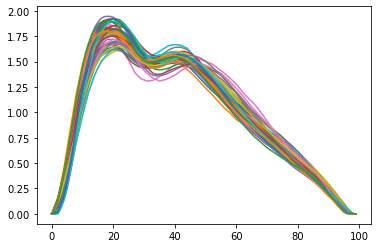

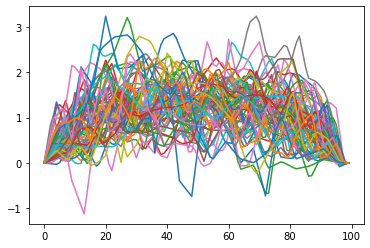

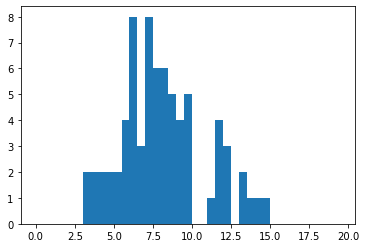

  3%|█▋                                                  | 5/160 [00:01<00:41,  3.73 batch/s, grad=0.20172, loss=1.0301]

%distance < 2:  0.0


100%|██████████████████████████████████████████████████| 160/160 [00:06<00:00, 22.92 batch/s, grad=0.20172, loss=0.9931]


20.3625
testing epoch: 10


100%|██████████████████████████████████████████████████| 714/714 [00:24<00:00, 29.35 batch/s, grad=0.20172, loss=1.0094]


20.99019607843137


[020] train (1/1): 100%|██████████████████████| 714/714 [00:12<00:00, 56.26 batch/s, grad=6.21959, loss=0.6042, ms=0.00]


testing epoch: 20


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

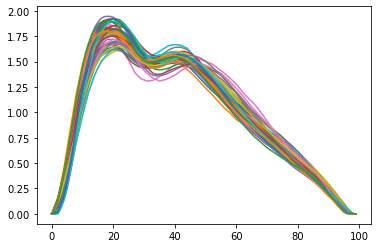

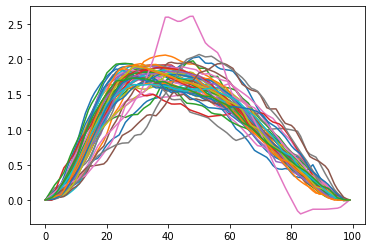

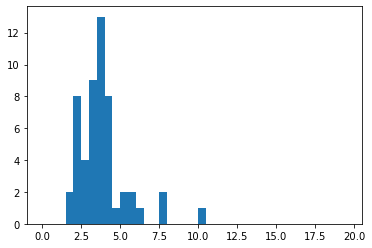

  1%|▎                                                   | 1/160 [00:00<01:13,  2.17 batch/s, grad=6.21959, loss=1.2350]

%distance < 2:  0.03773584905660377


100%|██████████████████████████████████████████████████| 160/160 [00:05<00:00, 29.88 batch/s, grad=6.21959, loss=1.3409]


5.10625
testing epoch: 20


100%|██████████████████████████████████████████████████| 714/714 [00:23<00:00, 30.51 batch/s, grad=6.21959, loss=0.5092]


2.869747899159664


[030] train (1/1): 100%|██████████████████████| 714/714 [00:12<00:00, 59.44 batch/s, grad=7.09413, loss=0.2554, ms=0.00]


testing epoch: 30


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

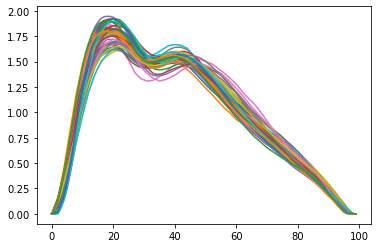

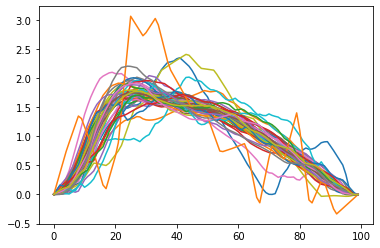

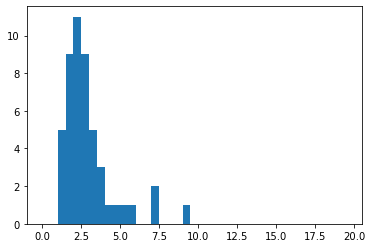

  4%|█▉                                                  | 6/160 [00:00<00:11, 12.93 batch/s, grad=7.09413, loss=1.5030]

%distance < 2:  0.2857142857142857


100%|██████████████████████████████████████████████████| 160/160 [00:05<00:00, 31.79 batch/s, grad=7.09413, loss=1.5273]


5.24375
testing epoch: 30


100%|██████████████████████████████████████████████████| 714/714 [00:22<00:00, 31.57 batch/s, grad=7.09413, loss=0.2373]


0.8907563025210085


[040] train (1/1): 100%|█████████████████████| 714/714 [00:12<00:00, 59.36 batch/s, grad=18.01429, loss=0.1669, ms=0.00]


testing epoch: 40


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

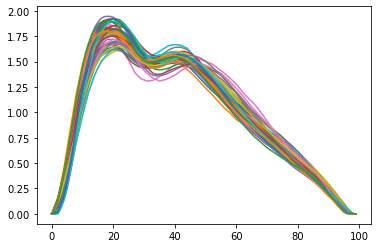

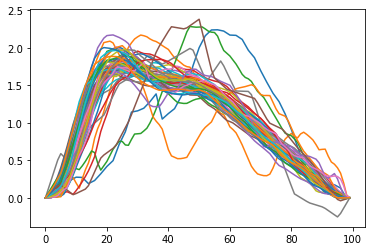

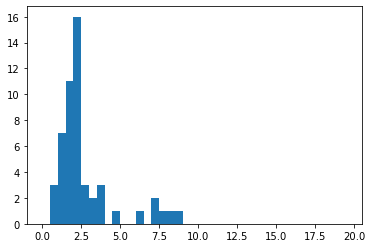

  2%|█▎                                                 | 4/160 [00:00<00:20,  7.69 batch/s, grad=18.01429, loss=1.7179]

%distance < 2:  0.40384615384615385


100%|█████████████████████████████████████████████████| 160/160 [00:05<00:00, 29.46 batch/s, grad=18.01429, loss=1.6514]


4.9
testing epoch: 40


100%|█████████████████████████████████████████████████| 714/714 [00:24<00:00, 28.67 batch/s, grad=18.01429, loss=0.1789]


0.5952380952380952


[050] train (1/1): 100%|██████████████████████| 714/714 [00:12<00:00, 59.32 batch/s, grad=5.49334, loss=0.1281, ms=0.00]


testing epoch: 50


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

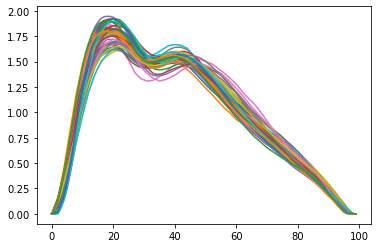

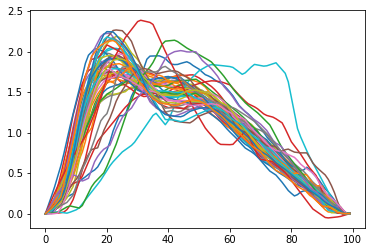

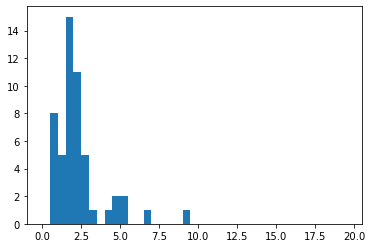

  2%|█▎                                                  | 4/160 [00:00<00:20,  7.66 batch/s, grad=5.49334, loss=1.7181]

%distance < 2:  0.5384615384615384


100%|██████████████████████████████████████████████████| 160/160 [00:05<00:00, 30.18 batch/s, grad=5.49334, loss=1.6683]


5.2625
testing epoch: 50


100%|██████████████████████████████████████████████████| 714/714 [00:22<00:00, 31.58 batch/s, grad=5.49334, loss=0.1256]


0.32492997198879553


[060] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 59.97 batch/s, grad=2.95633, loss=0.1085, ms=0.00]


testing epoch: 60


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

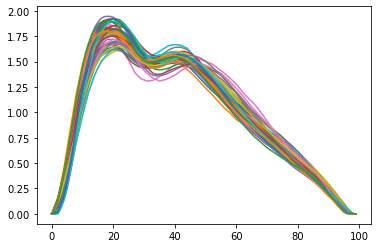

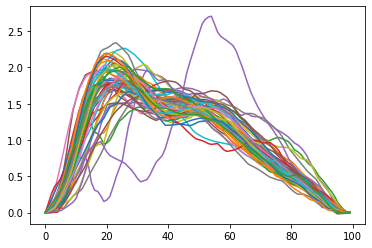

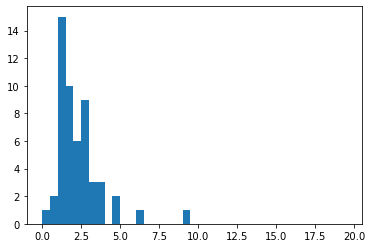

  3%|█▋                                                  | 5/160 [00:00<00:13, 11.21 batch/s, grad=2.95633, loss=1.6744]

%distance < 2:  0.5283018867924528


100%|██████████████████████████████████████████████████| 160/160 [00:05<00:00, 31.64 batch/s, grad=2.95633, loss=1.6632]


5.23125
testing epoch: 60


100%|██████████████████████████████████████████████████| 714/714 [00:20<00:00, 34.12 batch/s, grad=2.95633, loss=0.1204]


0.36134453781512604


[070] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.29 batch/s, grad=1.65824, loss=0.1279, ms=0.00]


testing epoch: 70


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

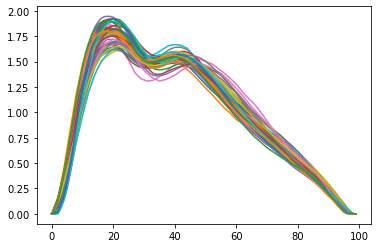

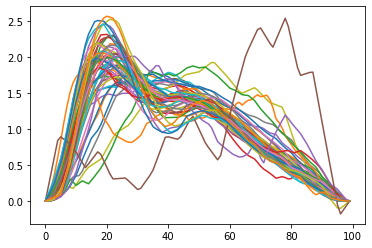

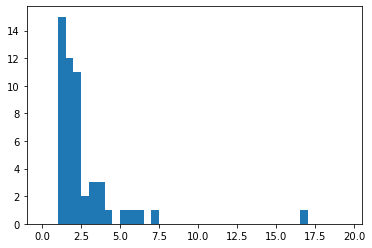

  2%|█▎                                                  | 4/160 [00:00<00:18,  8.25 batch/s, grad=1.65824, loss=1.6296]

%distance < 2:  0.5192307692307693


100%|██████████████████████████████████████████████████| 160/160 [00:05<00:00, 31.95 batch/s, grad=1.65824, loss=1.6848]


4.99375
testing epoch: 70


100%|██████████████████████████████████████████████████| 714/714 [00:22<00:00, 31.59 batch/s, grad=1.65824, loss=0.1128]


0.38375350140056025


[080] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 65.30 batch/s, grad=1.79233, loss=0.0782, ms=0.00]


testing epoch: 80


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

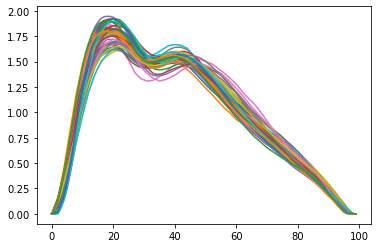

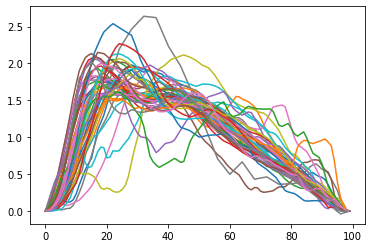

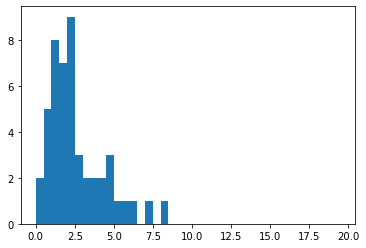

  4%|█▉                                                  | 6/160 [00:00<00:11, 12.89 batch/s, grad=1.79233, loss=1.6214]

%distance < 2:  0.4583333333333333


100%|██████████████████████████████████████████████████| 160/160 [00:04<00:00, 33.80 batch/s, grad=1.79233, loss=1.6630]


4.9125
testing epoch: 80


100%|██████████████████████████████████████████████████| 714/714 [00:20<00:00, 34.29 batch/s, grad=1.79233, loss=0.0945]


0.32492997198879553


[090] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 64.38 batch/s, grad=1.84229, loss=0.0449, ms=0.00]


testing epoch: 90


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

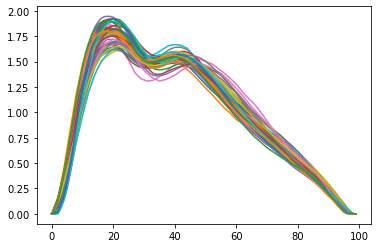

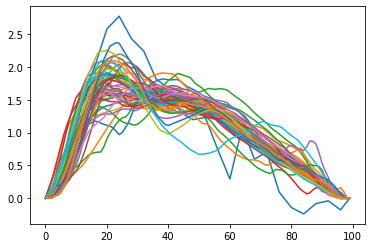

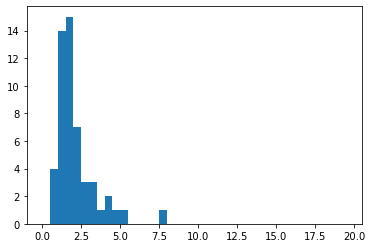

  4%|█▉                                                  | 6/160 [00:00<00:11, 13.83 batch/s, grad=1.84229, loss=1.6672]

%distance < 2:  0.6346153846153846


100%|██████████████████████████████████████████████████| 160/160 [00:04<00:00, 35.04 batch/s, grad=1.84229, loss=1.7004]


4.76875
testing epoch: 90


100%|██████████████████████████████████████████████████| 714/714 [00:22<00:00, 32.14 batch/s, grad=1.84229, loss=0.0466]


0.18347338935574228


[100] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 69.04 batch/s, grad=3.46876, loss=0.2276, ms=0.00]


testing epoch: 100


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

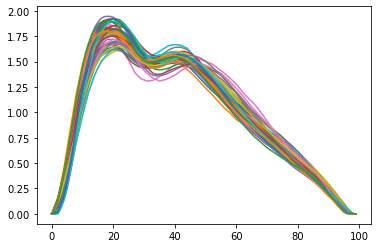

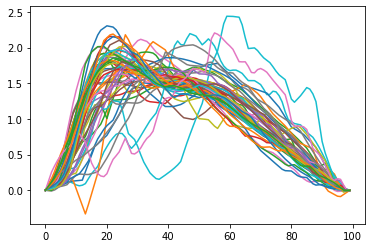

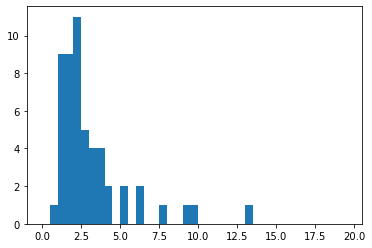

  4%|█▉                                                  | 6/160 [00:00<00:10, 14.31 batch/s, grad=3.46876, loss=1.6389]

%distance < 2:  0.3584905660377358


100%|██████████████████████████████████████████████████| 160/160 [00:04<00:00, 36.98 batch/s, grad=3.46876, loss=1.6080]


5.20625
testing epoch: 100


100%|██████████████████████████████████████████████████| 714/714 [00:22<00:00, 32.19 batch/s, grad=3.46876, loss=0.0977]


0.39775910364145656


[110] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.84 batch/s, grad=0.03901, loss=0.9876, ms=0.00]


testing epoch: 110


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

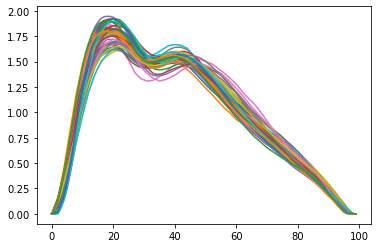

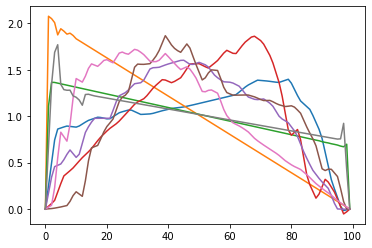

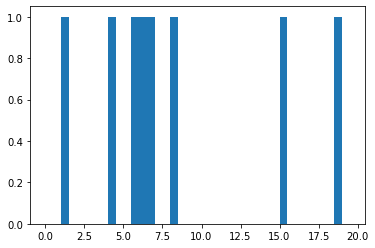

  4%|█▉                                                  | 6/160 [00:00<00:10, 15.33 batch/s, grad=0.03901, loss=1.0455]

%distance < 2:  0.125


100%|██████████████████████████████████████████████████| 160/160 [00:04<00:00, 39.85 batch/s, grad=0.03901, loss=1.0158]


33.1125
testing epoch: 110


100%|██████████████████████████████████████████████████| 714/714 [00:18<00:00, 38.31 batch/s, grad=0.03901, loss=0.9802]


33.95518207282913


[120] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 64.01 batch/s, grad=0.25501, loss=1.0137, ms=0.00]


testing epoch: 120


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

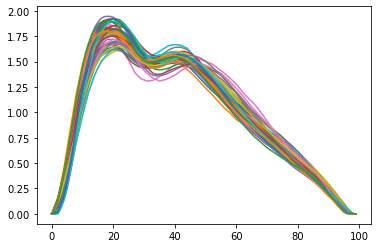

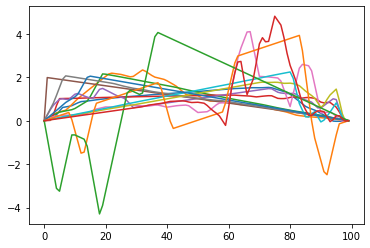

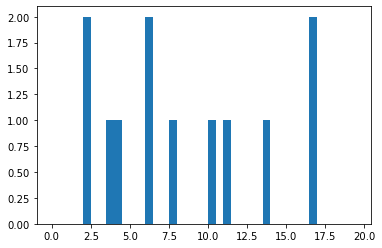

  4%|██▎                                                 | 7/160 [00:00<00:09, 15.94 batch/s, grad=0.25501, loss=1.0301]

%distance < 2:  0.0


 24%|████████████▍                                      | 39/160 [00:01<00:02, 45.77 batch/s, grad=0.25501, loss=1.0211]C:\Users\puzzle4\AppData\Local\Temp\ipykernel_1792\257588061.py:10: RuntimeWarning:

invalid value encountered in true_divide

100%|██████████████████████████████████████████████████| 160/160 [00:04<00:00, 39.70 batch/s, grad=0.25501, loss=0.9917]


36.95625
testing epoch: 120


100%|██████████████████████████████████████████████████| 714/714 [00:17<00:00, 39.71 batch/s, grad=0.25501, loss=1.0162]


37.7296918767507


[130] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 60.14 batch/s, grad=0.00508, loss=1.0130, ms=0.00]


testing epoch: 130


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 42.86 batch/s, grad=0.00508, loss=0.9911]


53.4125
testing epoch: 130


100%|██████████████████████████████████████████████████| 714/714 [00:17<00:00, 41.55 batch/s, grad=0.00508, loss=1.0130]


53.397759103641455


[140] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 64.10 batch/s, grad=0.00295, loss=1.0130, ms=0.00]


testing epoch: 140


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 47.53 batch/s, grad=0.00295, loss=0.9911]


53.4
testing epoch: 140


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.26 batch/s, grad=0.00295, loss=1.0130]


53.390756302521005


[150] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 62.70 batch/s, grad=0.00886, loss=1.0130, ms=0.00]


testing epoch: 150


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.14 batch/s, grad=0.00886, loss=0.9911]


53.4
testing epoch: 150


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 43.39 batch/s, grad=0.00886, loss=1.0130]


53.38375350140056


[160] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 62.86 batch/s, grad=0.00605, loss=1.0130, ms=0.00]


testing epoch: 160


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 47.20 batch/s, grad=0.00605, loss=0.9911]


53.4125
testing epoch: 160


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 43.45 batch/s, grad=0.00605, loss=1.0130]


53.397759103641455


[170] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 68.02 batch/s, grad=0.00177, loss=1.0130, ms=0.00]


testing epoch: 170


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 51.30 batch/s, grad=0.00177, loss=0.9911]


53.4125
testing epoch: 170


100%|██████████████████████████████████████████████████| 714/714 [00:15<00:00, 45.74 batch/s, grad=0.00177, loss=1.0130]


53.39495798319328


[180] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.48 batch/s, grad=0.00993, loss=1.0130, ms=0.00]


testing epoch: 180


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.98 batch/s, grad=0.00993, loss=0.9911]


53.4125
testing epoch: 180


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.60 batch/s, grad=0.00993, loss=1.0130]


53.397759103641455


[190] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 68.84 batch/s, grad=0.00001, loss=1.0130, ms=0.00]


testing epoch: 190


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 51.21 batch/s, grad=0.00001, loss=0.9911]


53.4125
testing epoch: 190


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 43.53 batch/s, grad=0.00001, loss=1.0130]


53.397759103641455


[200] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.48 batch/s, grad=0.00330, loss=1.0130, ms=0.00]


testing epoch: 200


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 45.93 batch/s, grad=0.00330, loss=0.9911]


53.4125
testing epoch: 200


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.52 batch/s, grad=0.00330, loss=1.0130]


53.397759103641455


[210] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.31 batch/s, grad=0.01126, loss=1.0130, ms=0.00]


testing epoch: 210


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 45.52 batch/s, grad=0.01126, loss=0.9911]


53.4125
testing epoch: 210


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.68 batch/s, grad=0.01126, loss=1.0130]


53.397759103641455


[220] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 62.61 batch/s, grad=0.01495, loss=1.0130, ms=0.00]


testing epoch: 220


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 44.32 batch/s, grad=0.01495, loss=0.9911]


53.4125
testing epoch: 220


100%|██████████████████████████████████████████████████| 714/714 [00:17<00:00, 40.13 batch/s, grad=0.01495, loss=1.0130]


53.397759103641455


[230] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 64.19 batch/s, grad=0.00642, loss=1.0130, ms=0.00]


testing epoch: 230


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.01 batch/s, grad=0.00642, loss=0.9911]


53.4125
testing epoch: 230


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.18 batch/s, grad=0.00642, loss=1.0130]


53.397759103641455


[240] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 60.09 batch/s, grad=0.00056, loss=1.0130, ms=0.00]


testing epoch: 240


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.56 batch/s, grad=0.00056, loss=0.9911]


53.4125
testing epoch: 240


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 43.00 batch/s, grad=0.00056, loss=1.0130]


53.397759103641455


[250] train (1/1): 100%|██████████████████████| 714/714 [00:12<00:00, 57.42 batch/s, grad=0.00911, loss=1.0130, ms=0.00]


testing epoch: 250


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 47.17 batch/s, grad=0.00911, loss=0.9911]


53.4125
testing epoch: 250


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.52 batch/s, grad=0.00911, loss=1.0130]


53.397759103641455


[260] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 66.92 batch/s, grad=0.00902, loss=1.0130, ms=0.00]


testing epoch: 260


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 50.46 batch/s, grad=0.00902, loss=0.9911]


53.4125
testing epoch: 260


100%|██████████████████████████████████████████████████| 714/714 [00:15<00:00, 45.84 batch/s, grad=0.00902, loss=1.0130]


53.397759103641455


[270] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.75 batch/s, grad=0.00731, loss=1.0130, ms=0.00]


testing epoch: 270


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.35 batch/s, grad=0.00731, loss=0.9911]


53.4125
testing epoch: 270


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.64 batch/s, grad=0.00731, loss=1.0130]


53.397759103641455


[280] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 68.84 batch/s, grad=0.02084, loss=1.0130, ms=0.00]


testing epoch: 280


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 50.70 batch/s, grad=0.02084, loss=0.9911]


53.4125
testing epoch: 280


100%|██████████████████████████████████████████████████| 714/714 [00:15<00:00, 44.64 batch/s, grad=0.02084, loss=1.0130]


53.397759103641455


[290] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 64.38 batch/s, grad=0.00677, loss=1.0130, ms=0.00]


testing epoch: 290


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 47.20 batch/s, grad=0.00677, loss=0.9911]


53.4125
testing epoch: 290


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.56 batch/s, grad=0.00677, loss=1.0130]


53.397759103641455


[300] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 62.44 batch/s, grad=0.01843, loss=1.0130, ms=0.00]


testing epoch: 300


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 45.82 batch/s, grad=0.01843, loss=0.9911]


53.4125
testing epoch: 300


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.13 batch/s, grad=0.01843, loss=1.0130]


53.397759103641455


[310] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.75 batch/s, grad=0.01132, loss=1.0130, ms=0.00]


testing epoch: 310


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 44.15 batch/s, grad=0.01132, loss=0.9911]


53.4125
testing epoch: 310


100%|██████████████████████████████████████████████████| 714/714 [00:17<00:00, 39.71 batch/s, grad=0.01132, loss=1.0130]


53.397759103641455


[320] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 64.01 batch/s, grad=0.01041, loss=1.0130, ms=0.00]


testing epoch: 320


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 44.73 batch/s, grad=0.01041, loss=0.9911]


53.4125
testing epoch: 320


100%|██████████████████████████████████████████████████| 714/714 [00:17<00:00, 41.93 batch/s, grad=0.01041, loss=1.0130]


53.397759103641455


[330] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 60.07 batch/s, grad=0.00965, loss=1.0130, ms=0.00]


testing epoch: 330


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 41.41 batch/s, grad=0.00965, loss=0.9911]


53.4125
testing epoch: 330


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.36 batch/s, grad=0.00965, loss=1.0130]


53.397759103641455


[340] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 62.96 batch/s, grad=0.00215, loss=1.0130, ms=0.00]


testing epoch: 340


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.35 batch/s, grad=0.00215, loss=0.9911]


53.4125
testing epoch: 340


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 43.16 batch/s, grad=0.00215, loss=1.0130]


53.397759103641455


[350] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 62.27 batch/s, grad=0.01041, loss=1.0130, ms=0.00]


testing epoch: 350


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 51.10 batch/s, grad=0.01041, loss=0.9911]


53.4125
testing epoch: 350


100%|██████████████████████████████████████████████████| 714/714 [00:15<00:00, 45.62 batch/s, grad=0.01041, loss=1.0130]


53.397759103641455


[360] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.93 batch/s, grad=0.01275, loss=1.0130, ms=0.00]


testing epoch: 360


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.98 batch/s, grad=0.01275, loss=0.9911]


53.4125
testing epoch: 360


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.96 batch/s, grad=0.01275, loss=1.0130]


53.397759103641455


[370] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 68.42 batch/s, grad=0.01763, loss=1.0130, ms=0.00]


testing epoch: 370


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 51.21 batch/s, grad=0.01763, loss=0.9911]


53.4125
testing epoch: 370


100%|██████████████████████████████████████████████████| 714/714 [00:15<00:00, 45.57 batch/s, grad=0.01763, loss=1.0130]


53.397759103641455


[380] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.84 batch/s, grad=0.01091, loss=1.0130, ms=0.00]


testing epoch: 380


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.77 batch/s, grad=0.01091, loss=0.9911]


53.4125
testing epoch: 380


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.48 batch/s, grad=0.01091, loss=1.0130]


53.397759103641455


[390] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 65.30 batch/s, grad=0.00233, loss=1.0130, ms=0.00]


testing epoch: 390


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 45.52 batch/s, grad=0.00233, loss=0.9911]


53.4125
testing epoch: 390


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.56 batch/s, grad=0.00233, loss=1.0130]


53.397759103641455


[400] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.22 batch/s, grad=0.01002, loss=1.0130, ms=0.00]


testing epoch: 400


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.98 batch/s, grad=0.01002, loss=0.9911]


53.4125
testing epoch: 400


100%|██████████████████████████████████████████████████| 714/714 [00:17<00:00, 40.85 batch/s, grad=0.01002, loss=1.0130]


53.396358543417364


[410] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.75 batch/s, grad=0.00200, loss=1.0130, ms=0.00]


testing epoch: 410


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 46.56 batch/s, grad=0.00200, loss=0.9911]


53.4125
testing epoch: 410


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.68 batch/s, grad=0.00200, loss=1.0130]


53.397759103641455


[420] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 60.46 batch/s, grad=0.00011, loss=1.0130, ms=0.00]


testing epoch: 420


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 44.44 batch/s, grad=0.00011, loss=0.9911]


53.4125
testing epoch: 420


100%|██████████████████████████████████████████████████| 714/714 [00:17<00:00, 40.73 batch/s, grad=0.00011, loss=1.0130]


53.397759103641455


[430] train (1/1): 100%|██████████████████████| 714/714 [00:10<00:00, 68.42 batch/s, grad=0.00172, loss=1.0130, ms=0.00]


testing epoch: 430


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 49.69 batch/s, grad=0.00172, loss=0.9911]


53.4125
testing epoch: 430


100%|██████████████████████████████████████████████████| 714/714 [00:16<00:00, 42.69 batch/s, grad=0.00172, loss=1.0130]


53.397759103641455


[440] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 63.93 batch/s, grad=0.00295, loss=1.0130, ms=0.00]


testing epoch: 440


  0%|                                                                                       | 0/160 [00:00<?, ? batch/s]

100%|██████████████████████████████████████████████████| 160/160 [00:03<00:00, 48.09 batch/s, grad=0.00295, loss=0.9911]


53.4125
testing epoch: 440


100%|██████████████████████████████████████████████████| 714/714 [00:17<00:00, 41.84 batch/s, grad=0.00295, loss=1.0130]


53.397759103641455


[449] train (1/1): 100%|██████████████████████| 714/714 [00:11<00:00, 64.21 batch/s, grad=0.00880, loss=1.0130, ms=0.00]


In [33]:
trainlossarg = []
testlossarg1arg = []
testlossarg2arg = []
shapeloss1arg = []
shapeloss2arg = []
ppmarg1 = []
ppmarg2 = []
dist2arg1 = []
dist2arg2 = []
writer = SummaryWriter()
for a in range(450):
    model.train()
    train_loss, model_size = train_model(a,train_dataset,model,criterion,optimizer,None,device=device)
    trainlossarg.append(train_loss)
    #writer.add_scalar('Loss/train', train_loss, a)
    if a > 0 and a % 10 == 0:
        testloss1, shapeloss1, ppm1, dist21 = test_model(test_dataset,model,criterion,a,device=device, showfdat = True)
        testloss2, shapeloss2, ppm2, dist22 = test_model(train_dataset,model,criterion,a,device=device)
        testlossarg1arg.append(testloss1)
        shapeloss1arg.append(shapeloss1)
        testlossarg2arg.append(testloss2)
        shapeloss2arg.append(shapeloss2)
        ppmarg1.append(ppm1)
        ppmarg2.append(ppm2)
        dist2arg1.append(dist21)
        dist2arg2.append(dist22)
        writer.add_scalar('Loss/test', testloss1)
        writer.add_scalar('Loss/test', testloss2)
        th.save(model.state_dict(), "./saved_model/deap5ch/"+str(a).zfill(3)+"facemesh5ch_normalizedlabel.pth")
    #if a % 100 == 0:
        #th.save(model.state_dict(), "./saved_model/"+str(a)+"_FFTloss.pth")

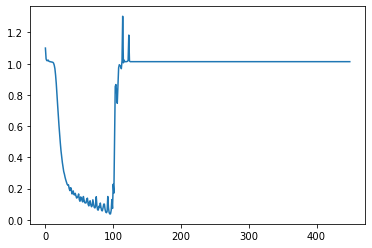

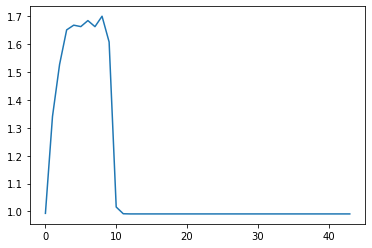

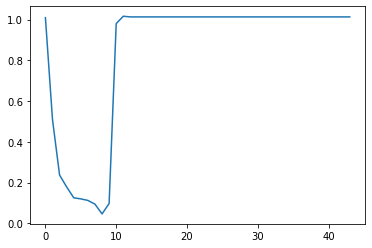

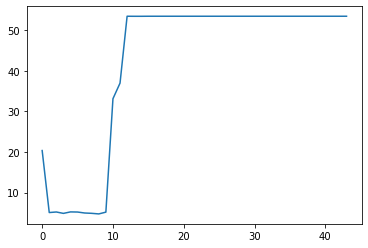

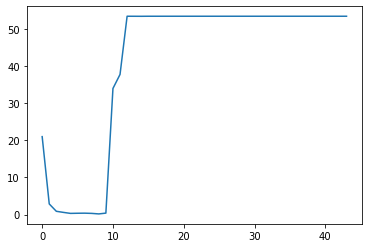

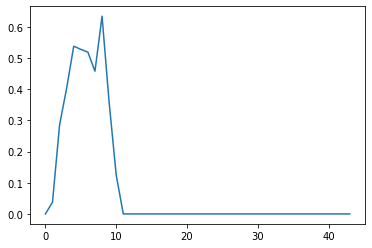

In [35]:
plt.plot(trainlossarg)
plt.show()
plt.plot(testlossarg1arg)
plt.show()
plt.plot(testlossarg2arg)
plt.show()
plt.plot(ppmarg1)
plt.show()
plt.plot(ppmarg2)
plt.show()
plt.plot(dist2arg1)
plt.show()

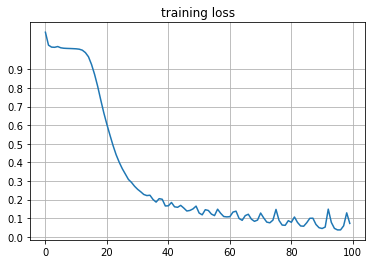

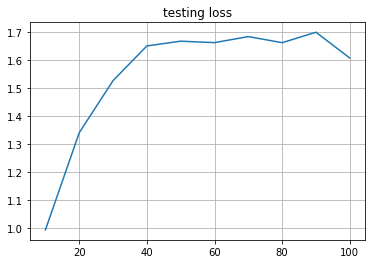

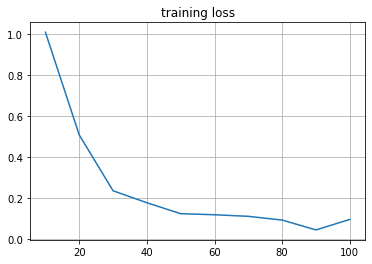

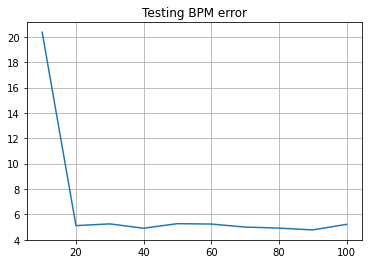

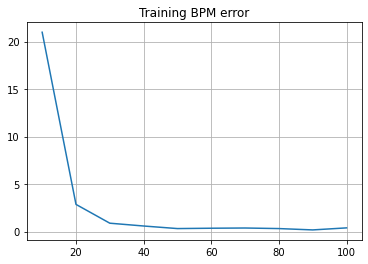

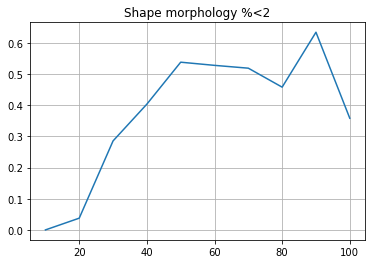

In [47]:
xep = [10,20,30,40,50,60,70,80,90,100]
fig = plt.figure()
ax = fig.gca()
ax.set_yticks(np.arange(0, 1, 0.1))
ax.grid()
plt.plot(trainlossarg[:100])
plt.title("training loss")
plt.show()
plt.plot(xep,testlossarg1arg[:10])
plt.grid()
plt.title("testing loss")
plt.show()
plt.plot(xep,testlossarg2arg[:10])
plt.grid()
plt.title("training loss")
plt.show()
plt.plot(xep,ppmarg1[:10])
plt.grid()
plt.title("Testing BPM error")
plt.show()
plt.plot(xep,ppmarg2[:10])
plt.grid()
plt.title("Training BPM error")
plt.show()
plt.plot(xep,dist2arg1[:10])
plt.grid()
plt.title("Shape morphology %<2")
plt.show()

In [28]:
len(test_dataset.filelist)

160

# Pulse group dump file generation

In [33]:
def creaauth(model,dataset):
    model.eval()
    atr = {}
    for ind in range(len(dataset)):
    #for ind in range(2):
        #print(dataset.filelist[ind])
        x,y = dataset[ind]
        estimates = model(x.unsqueeze(0).to(device)).detach().cpu()
        y = center_trim(y.unsqueeze(0), estimates.shape[-1])
        '''
        fig = go.Figure()
        fig.add_trace(go.Scatter(y=y[0,0,:],
                    mode='lines',
                    name='GT'))
        fig.add_trace(go.Scatter(y=estimates[0,0,:],
                    mode='lines',
                    name='Estimate'))
        fig.update_layout(
            title="filename: "+dataset.filelist[ind],
        )
        fig.show()
        plt.plot(y[0,0,:])
        plt.plot(estimates[0,0,:])
        plt.show()'''
        #oriperson = iteroutlierremove(createg(tosignature(y[0,0].cpu().numpy()),y[0,0].cpu().numpy()))
        #plt.plot(oriperson.T)
        #plt.show()
        estperson = iteroutlierremove(createg(tosignature(estimates[0,0].cpu().numpy()),estimates[0,0].cpu().numpy()))
        '''distance = np.mean(similarperson(estperson,oriperson))
        plt.plot(oriperson.T)
        plt.show()
        plt.plot(estperson.T)
        plt.show()'''
        #print(distance)
        atr[dataset.filelist[ind]] = estperson.T
    return atr

In [34]:
model.load_state_dict(th.load("./saved_model/deap5ch/090facemesh5ch_normalizedlabel.pth"))

<All keys matched successfully>

In [35]:
tatr = creaauth(model,test_dataset)

In [36]:
tatr.keys()

dict_keys(['s19_trial01.avi.npy', 's19_trial02.avi.npy', 's19_trial03.avi.npy', 's19_trial04.avi.npy', 's19_trial05.avi.npy', 's19_trial06.avi.npy', 's19_trial07.avi.npy', 's19_trial08.avi.npy', 's19_trial09.avi.npy', 's19_trial10.avi.npy', 's19_trial11.avi.npy', 's19_trial12.avi.npy', 's19_trial13.avi.npy', 's19_trial14.avi.npy', 's19_trial15.avi.npy', 's19_trial16.avi.npy', 's19_trial17.avi.npy', 's19_trial18.avi.npy', 's19_trial19.avi.npy', 's19_trial20.avi.npy', 's19_trial21.avi.npy', 's19_trial22.avi.npy', 's19_trial23.avi.npy', 's19_trial24.avi.npy', 's19_trial25.avi.npy', 's19_trial26.avi.npy', 's19_trial27.avi.npy', 's19_trial28.avi.npy', 's19_trial29.avi.npy', 's19_trial30.avi.npy', 's19_trial31.avi.npy', 's19_trial32.avi.npy', 's19_trial33.avi.npy', 's19_trial34.avi.npy', 's19_trial35.avi.npy', 's19_trial36.avi.npy', 's19_trial37.avi.npy', 's19_trial38.avi.npy', 's19_trial39.avi.npy', 's19_trial40.avi.npy', 's20_trial01.avi.npy', 's20_trial02.avi.npy', 's20_trial03.avi.npy', 

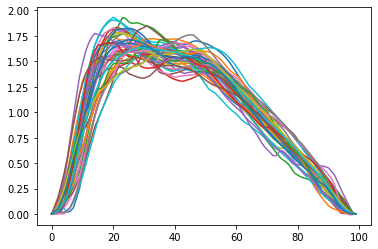

In [39]:
plt.plot(tatr['s19_trial07.avi.npy'])
plt.show()

In [37]:
np.save("tatr5ch.npy", tatr)

# Raw signal dump file generation

In [40]:
def creatraditional(model,dataset):
    model.eval()
    atr = {}
    for ind in range(len(dataset)):
    #for ind in range(2):
        #print(dataset.filelist[ind])
        x,y = dataset[ind]
        estimates = model(x.unsqueeze(0).to(device)).detach().cpu()
        y = center_trim(y.unsqueeze(0), estimates.shape[-1])
        '''
        fig = go.Figure()
        fig.add_trace(go.Scatter(y=y[0,0,:],
                    mode='lines',
                    name='GT'))
        fig.add_trace(go.Scatter(y=estimates[0,0,:],
                    mode='lines',
                    name='Estimate'))
        fig.update_layout(
            title="filename: "+dataset.filelist[ind],
        )
        fig.show()
        plt.plot(y[0,0,:])
        plt.plot(estimates[0,0,:])
        plt.show()'''
        #oriperson = iteroutlierremove(createg(tosignature(y[0,0].cpu().numpy()),y[0,0].cpu().numpy()))
        #plt.plot(oriperson.T)
        #plt.show()
        #estperson = iteroutlierremove(createg(tosignature(estimates[0,0].cpu().numpy()),estimates[0,0].cpu().numpy()))
        '''distance = np.mean(similarperson(estperson,oriperson))
        plt.plot(oriperson.T)
        plt.show()
        plt.plot(estperson.T)
        plt.show()'''
        #print(distance)
        atr[dataset.filelist[ind]] = [y[0,0].cpu().numpy(),estimates[0,0].cpu().numpy()]
    return atr

In [41]:
trawsignal = creatraditional(model,test_dataset)

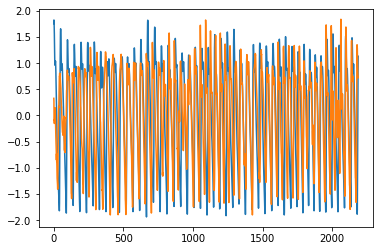

In [42]:
plt.plot(trawsignal['s19_trial01.avi.npy'][0])
plt.plot(trawsignal['s19_trial01.avi.npy'][1])
plt.show()

In [43]:
trawsignal['s20_trial21.avi.npy'][1].shape

(2188,)

In [49]:
np.save("trawsignalfacemesh380.npy", trawsignal)

# Shape visualization

In [47]:
def creaevol(model,dataset,epoc,ind):
    model.eval()
    x,y = dataset[ind]
    estimates = model(x.unsqueeze(0).to(device)).detach().cpu()
    y = center_trim(y.unsqueeze(0), estimates.shape[-1])
    '''
    fig = go.Figure()
    fig.add_trace(go.Scatter(y=y[0,0,:],
                mode='lines',
                name='GT'))
    fig.add_trace(go.Scatter(y=estimates[0,0,:],
                mode='lines',
                name='Estimate'))
    fig.update_layout(
        title="filename: "+dataset.filelist[0],
    )
    fig.show()
    plt.plot(y[0,0,:])
    plt.plot(estimates[0,0,:])
    plt.show()'''
    oriperson = iteroutlierremove(createg(tosignature(y[0,0].cpu().numpy()),y[0,0].cpu().numpy())).T
    #plt.plot(oriperson.T)
    #plt.show()
    estperson = iteroutlierremove(createg(tosignature(estimates[0,0].cpu().numpy()),estimates[0,0].cpu().numpy())).T
    '''distance = np.mean(similarperson(estperson,oriperson))
    plt.plot(oriperson,'xkcd:blue')
    plt.title("Ground Truth Pulse Group")
    plt.show()
    plt.plot(estperson,'xkcd:blue')
    plt.title("Estimated Pulse Group, "+str(epoc)+" Epochs")
    plt.show()'''
    mo = np.array([np.mean(t) for t in oriperson])
    so = np.array([np.std(t) for t in oriperson])
    me = np.array([np.mean(t) for t in estperson])
    se = np.array([np.std(t) for t in estperson])
    '''plt.plot(mo+so)
    plt.plot(mo-so)
    plt.plot(mo)
    plt.show()
    plt.plot(me+se)
    plt.plot(me-se)
    plt.plot(me)
    plt.show()'''
    fig, ax = plt.subplots()
    ax.plot(np.arange(100),mo, '-', label='Ground Truth')
    ax.fill_between(np.arange(100),mo+so,mo-so, alpha=0.4, label='±1 std. dev.')
    ax.plot(np.arange(100),me, '-', label='Our estimated')
    ax.fill_between(np.arange(100),me+se,me-se, alpha=0.4, label='±1 std. dev.')
    ax.legend()
    plt.title("Shape Morphology compare, "+str(epoc)+" Epochs, person no."+str(ind))
    plt.show()

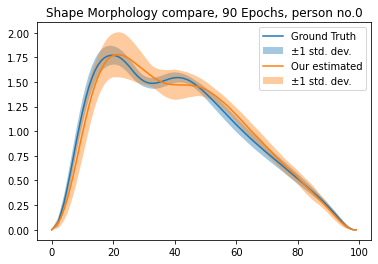

In [54]:
creaevol(model,test_dataset,90,0)

# Signal comparison plot generation

In [50]:
'''
writef = True: save the generated plot
name: the filename
a:number of random selected samples
'''
def nbplot(name,model,dataset,a,indc = None, writef = False):
    model.eval()
    if indc == None:
        testsample_index = random.choices(np.arange(len(dataset)),k=a)
    else:
        testsample_index = indc
    print(testsample_index)
    with open(name+'.html', 'a') as f:
        for ind in testsample_index:
            x,y = dataset[ind]
            estimates = model(x.unsqueeze(0).to(device)).detach().cpu()
            y = center_trim(y.unsqueeze(0), estimates.shape[-1])
            fig = go.Figure()
            fig.add_trace(go.Scatter(y=y[0,0,:],
                        mode='lines',
                        name='GT'))
            fig.add_trace(go.Scatter(y=estimates[0,0,:],
                        mode='lines',
                        name='Estimate'))
            fig.update_layout(
                title="filename: "+dataset.filelist[ind],
            )
            fig.show()
            plt.plot(y[0,0,:])
            plt.plot(estimates[0,0,:])
            plt.show()
            oriperson = iteroutlierremove(createg(tosignature(y[0,0].cpu().numpy()),y[0,0].cpu().numpy()))
            #plt.plot(oriperson.T)
            #plt.show()
            estperson = iteroutlierremove(createg(tosignature(estimates[0,0].cpu().numpy()),estimates[0,0].cpu().numpy()))
            distance = np.mean(similarperson(estperson,oriperson))
            plt.plot(oriperson.T)
            plt.show()
            plt.plot(estperson.T)
            plt.show()
            print(distance)
            if writef:
                f.write(fig.to_html(full_html=False, include_plotlyjs='cdn'))

In [48]:
model.load_state_dict(th.load("./saved_model/deap5ch/090facemesh5ch_normalizedlabel.pth"))

<All keys matched successfully>

[493, 146, 49, 32, 691, 367, 95, 17, 285, 64, 334, 609, 373, 126, 624, 71, 707, 580, 662, 476]


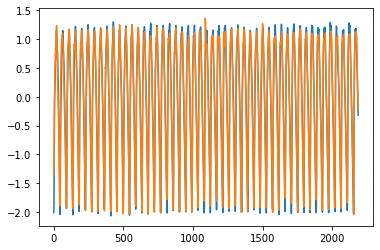

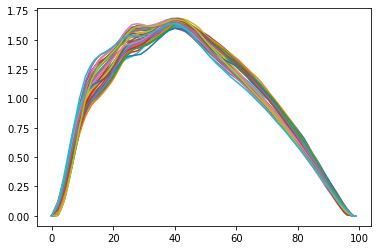

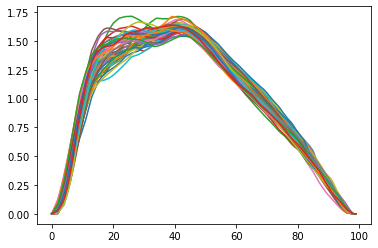

1.1186666900474262


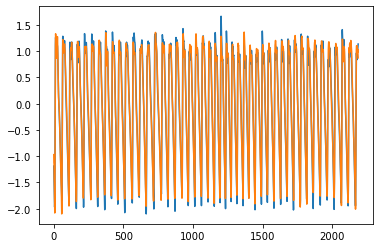

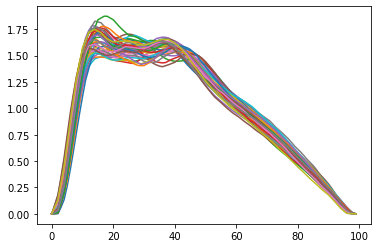

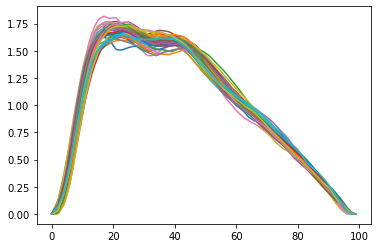

0.9012917340670864


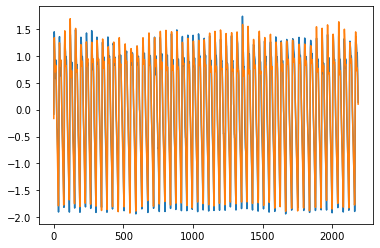

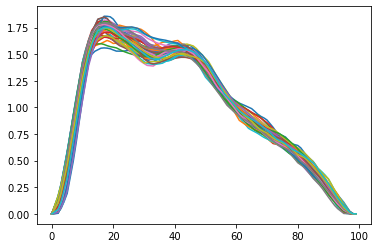

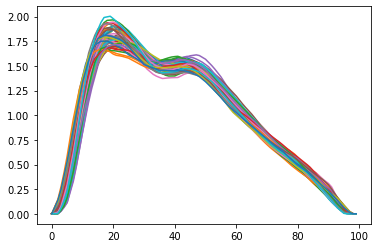

1.4658094552750107


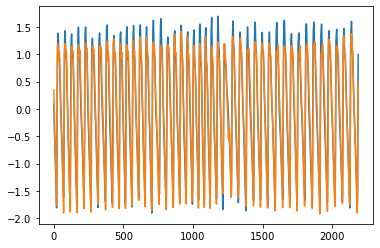

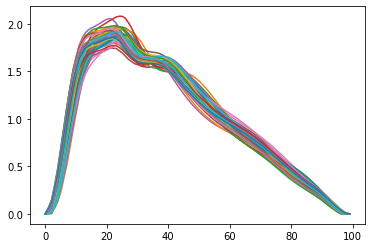

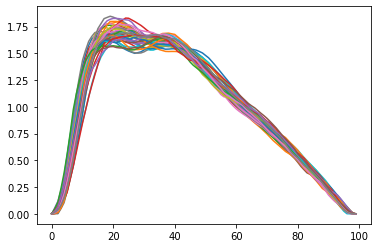

1.6524573991130556


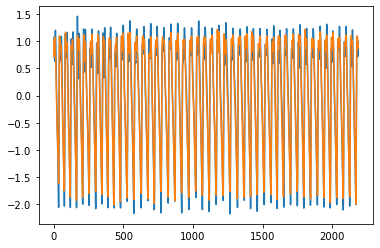

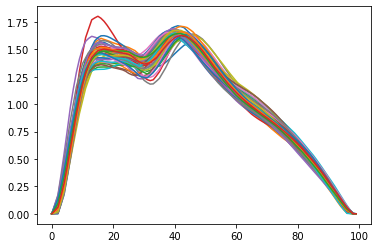

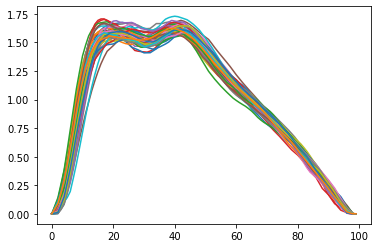

1.284626266930368


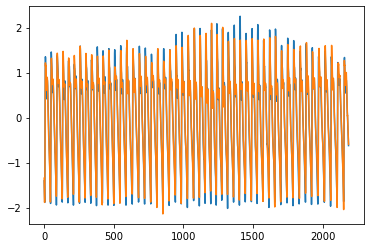

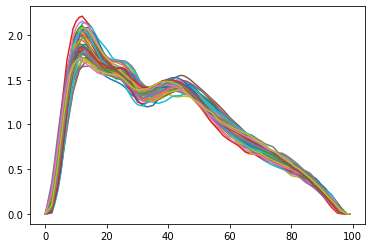

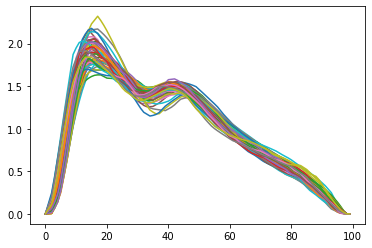

1.2285362183920956


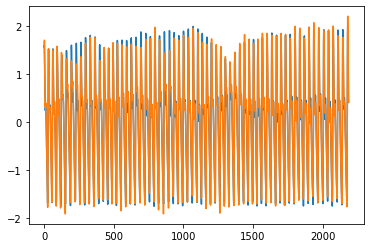

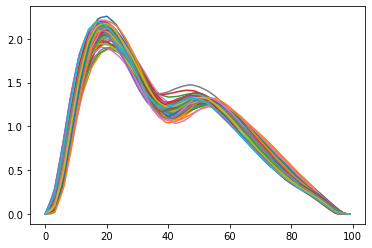

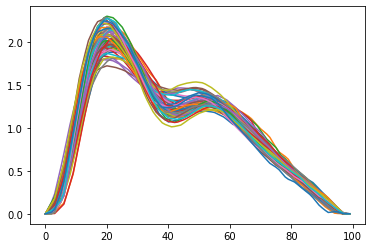

1.2348336273605314


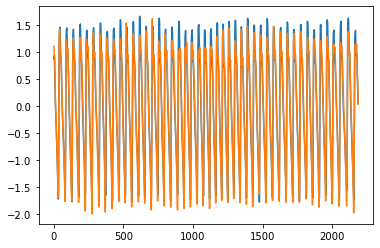

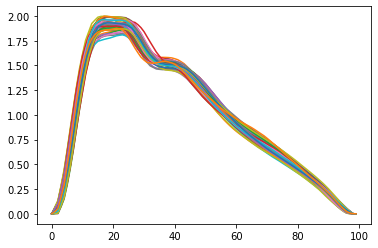

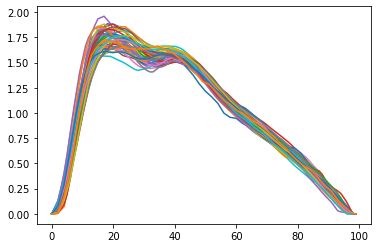

2.421464474395987


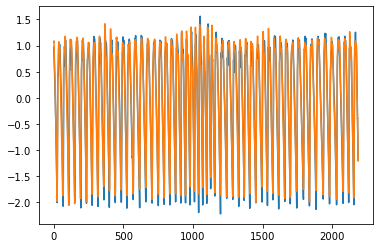

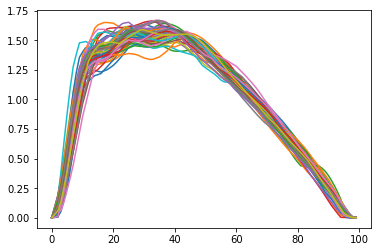

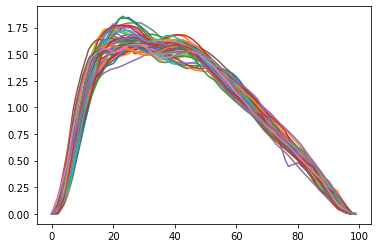

1.1812971798231855


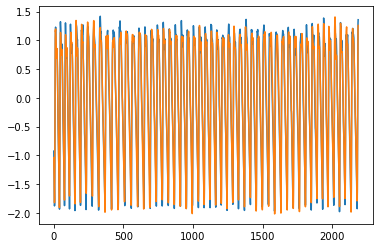

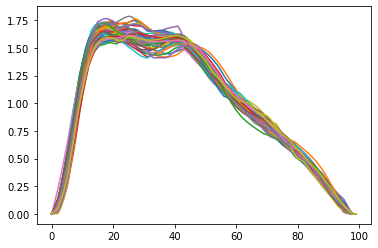

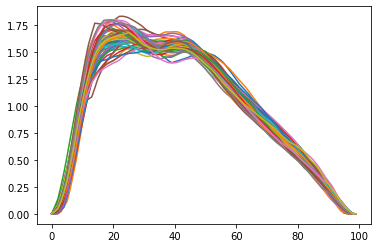

1.43359307204218


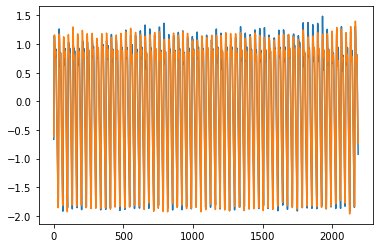

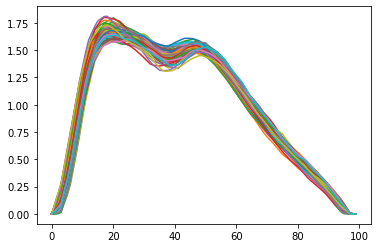

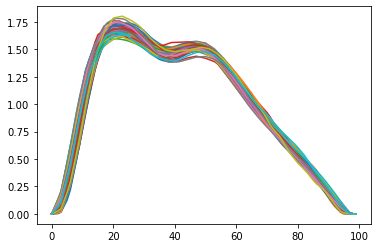

0.9237914851577487


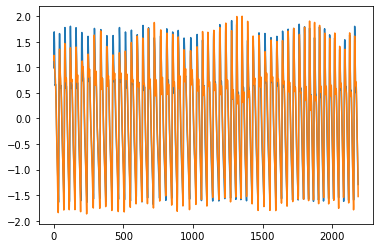

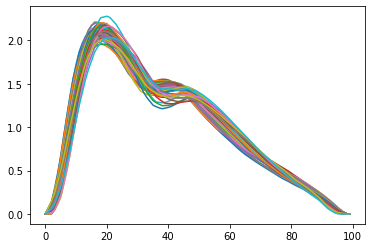

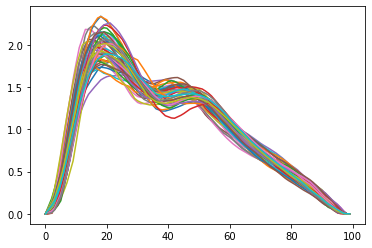

1.6177836323677461


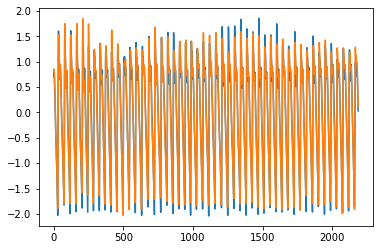

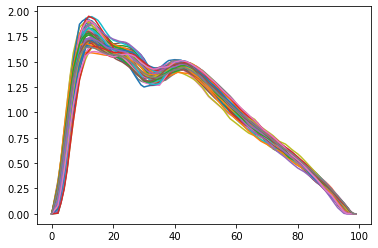

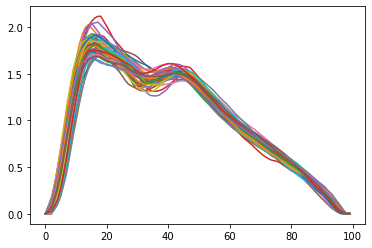

1.4545032622336524


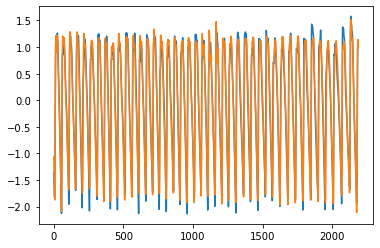

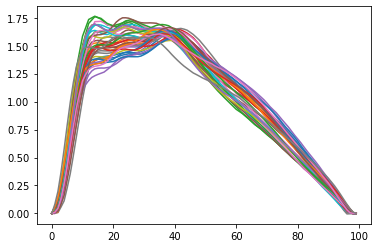

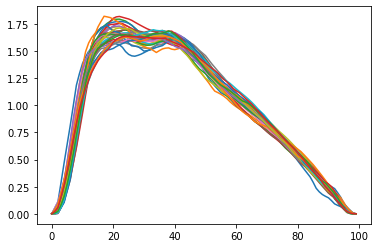

0.6873790237149211


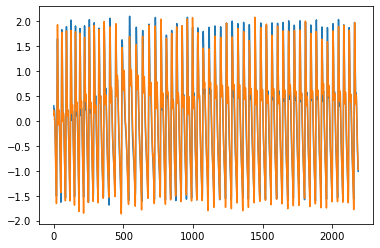

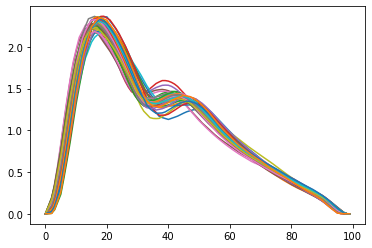

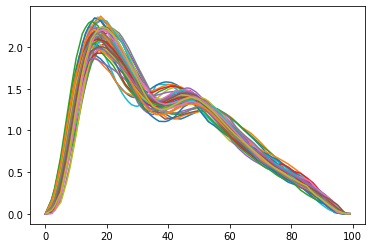

1.8036693638914345


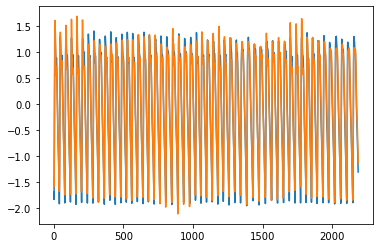

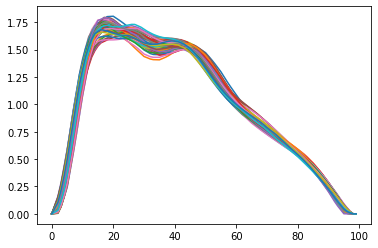

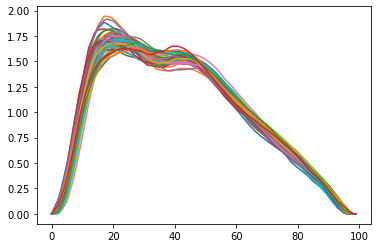

1.5320955194454342


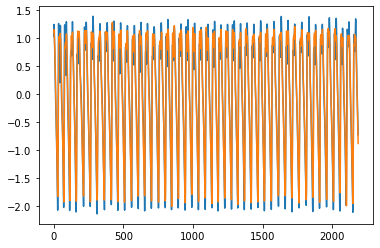

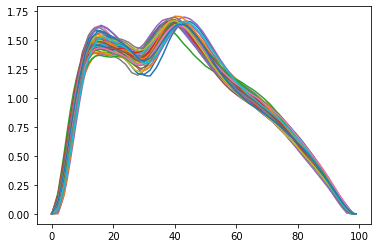

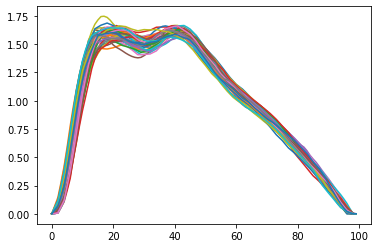

1.47247480308327


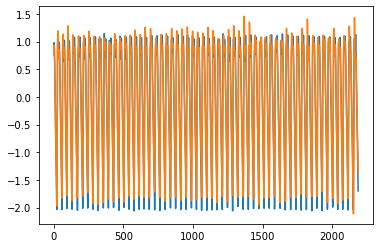

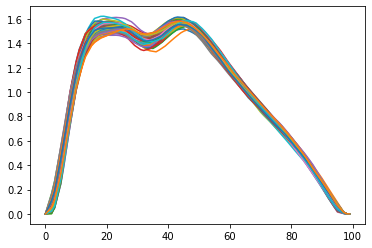

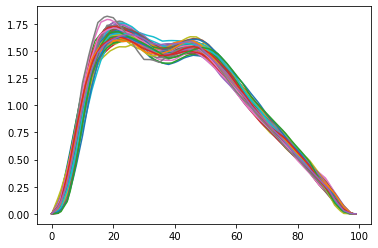

2.160142433581136


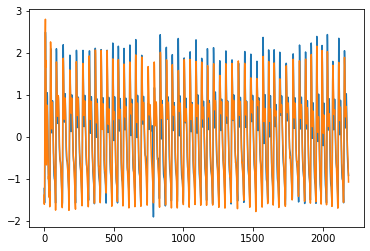

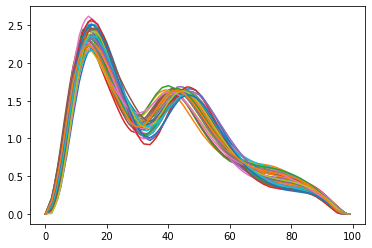

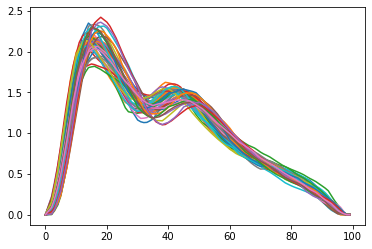

1.4334496879521583


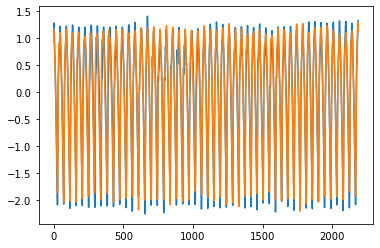

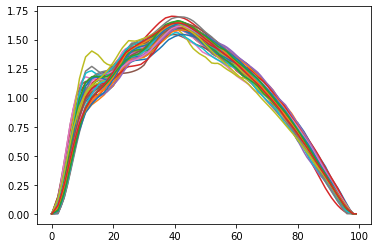

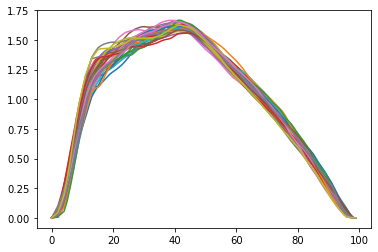

1.3745715876917177


In [51]:
nbplot('090facemesh5ch_normalizedlabel_training',model,train_dataset,20,writef = True)

[146, 103, 148, 21, 154, 138, 152, 142, 39, 102, 49, 48, 40, 101, 158, 114, 110, 4, 101, 86]


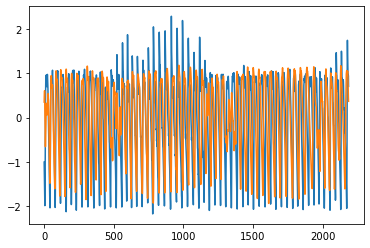

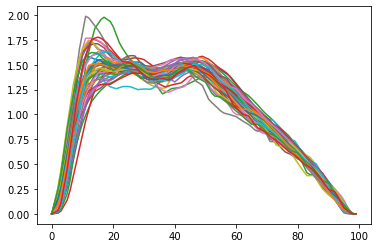

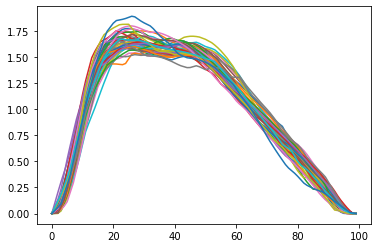

1.6868188531712327


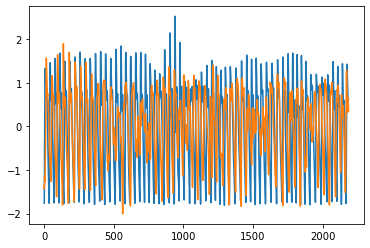

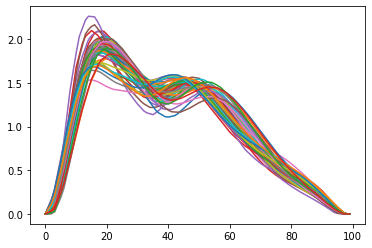

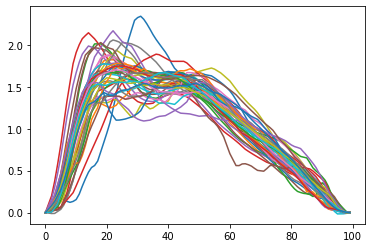

1.970568168142492


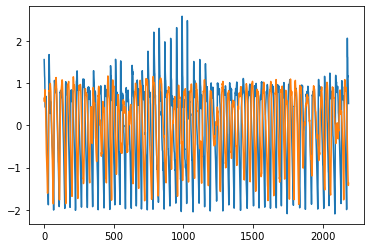

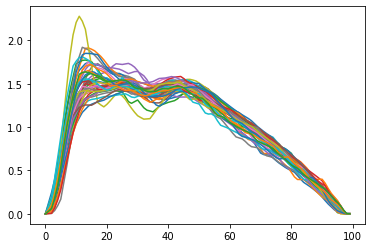

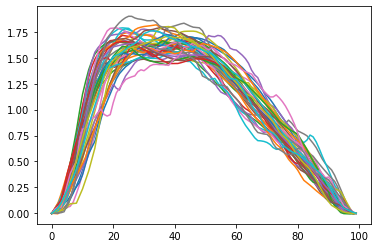

1.9946336082047584


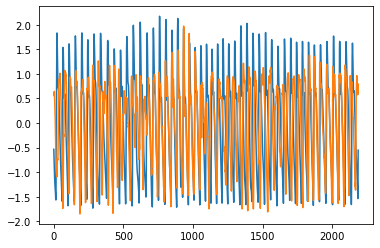

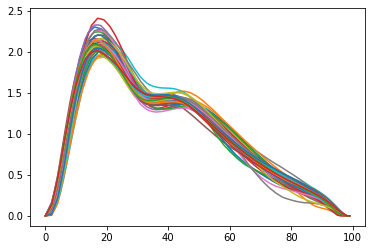

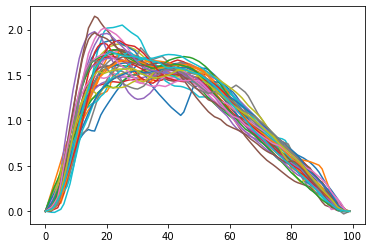

3.0387769310099837


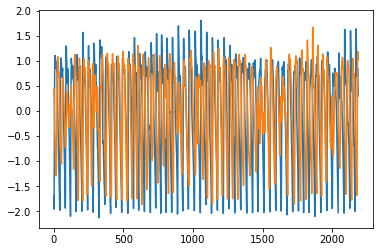

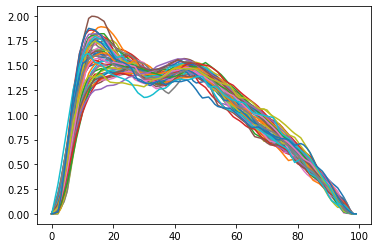

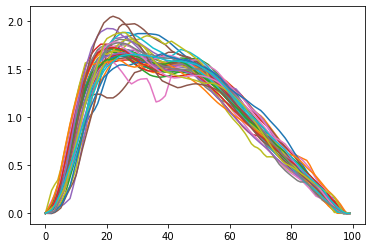

1.8698977238054026


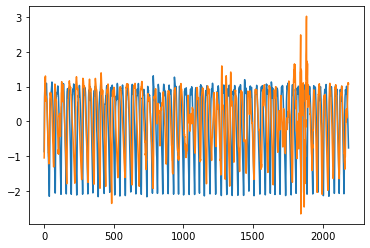

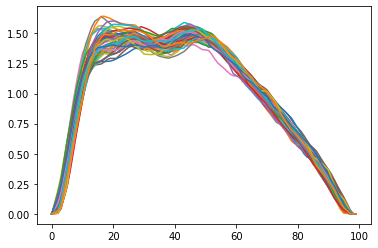

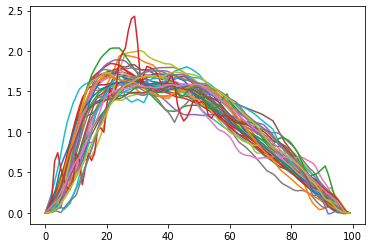

3.086996504717744


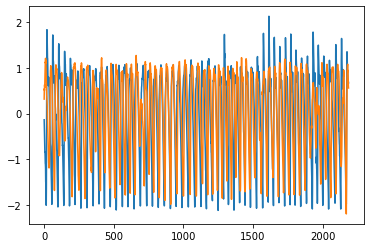

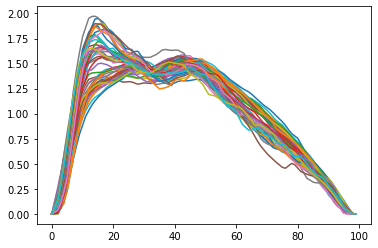

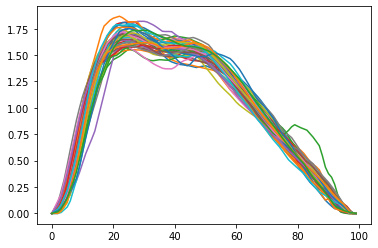

1.5236400254382754


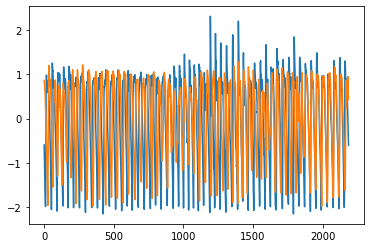

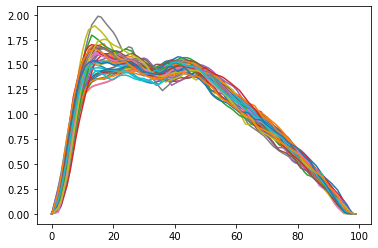

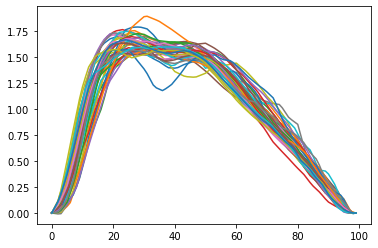

1.8979836782803927


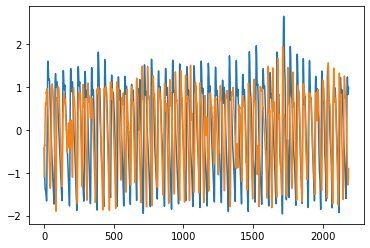

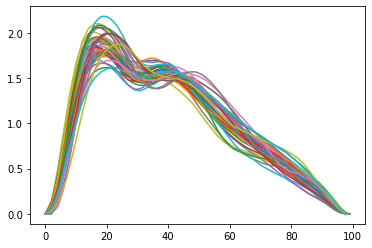

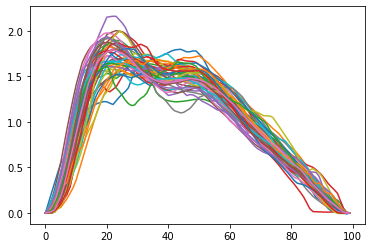

1.5746939266802702


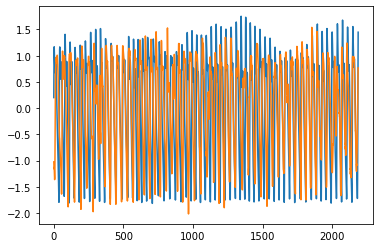

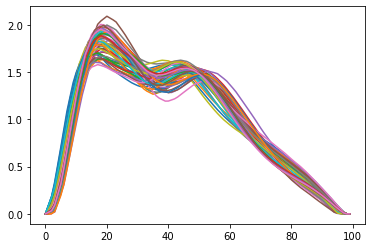

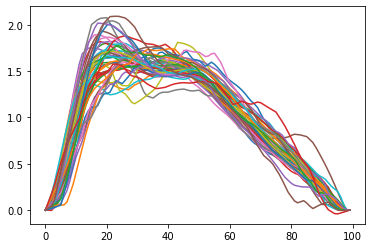

1.5902952858399764


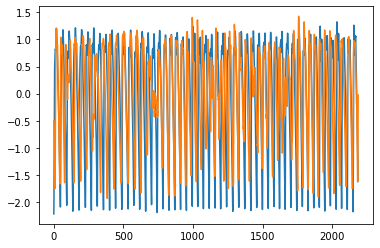

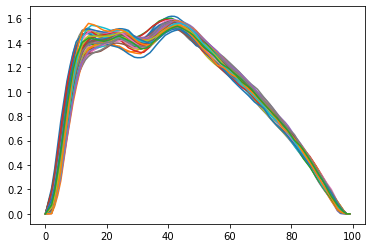

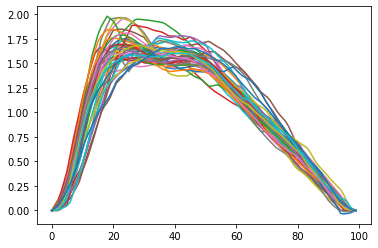

3.4290538524175185


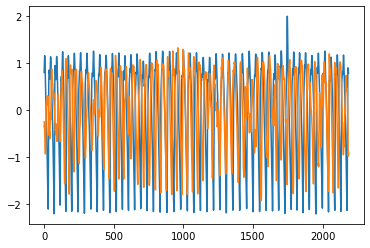

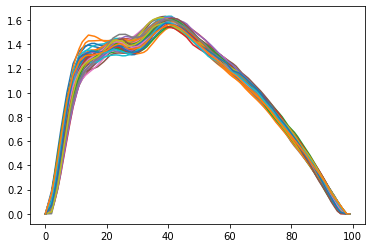

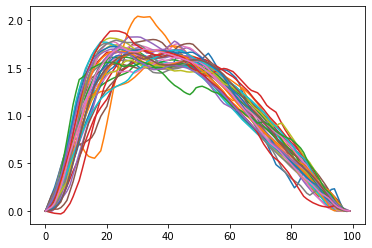

3.9094657952478205


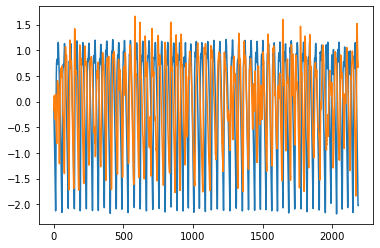

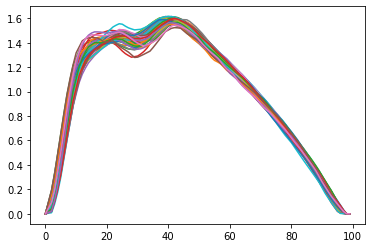

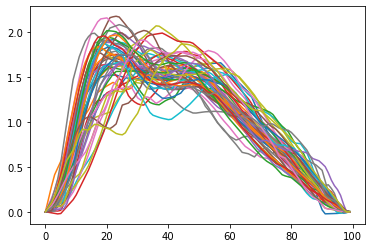

5.249010281471189


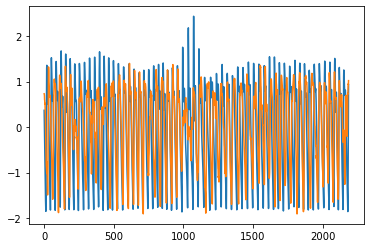

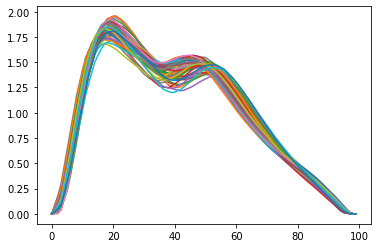

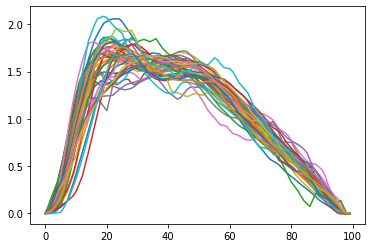

2.7020735578175783


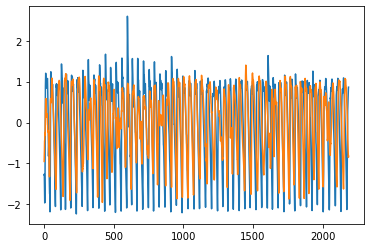

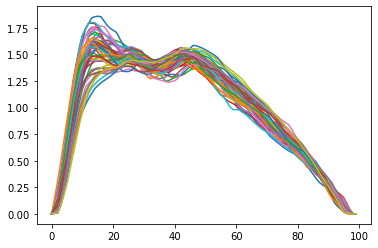

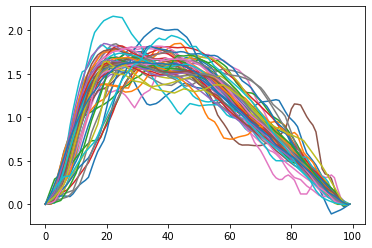

2.5396382824246175


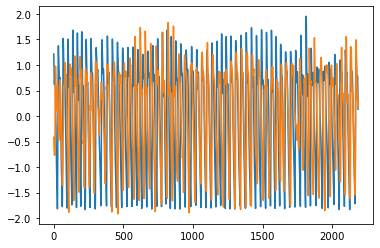

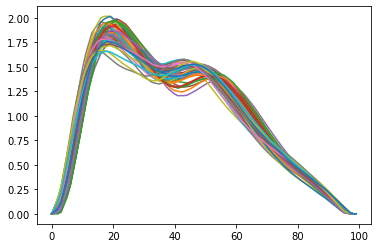

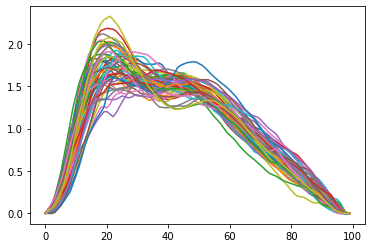

2.020703912561977


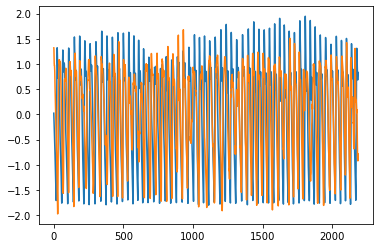

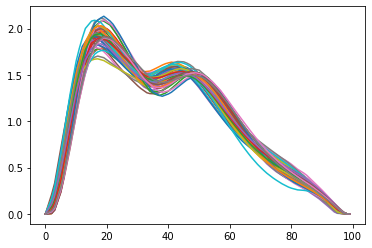

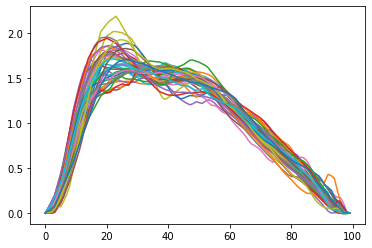

2.4039213042399306


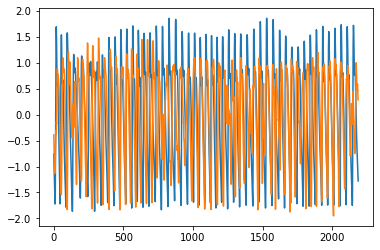

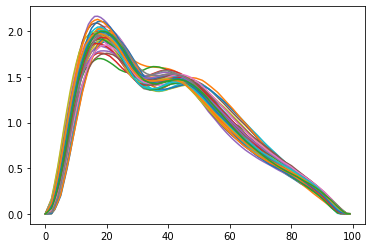

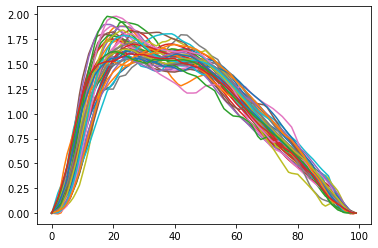

2.547256782350323


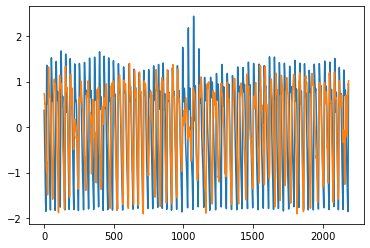

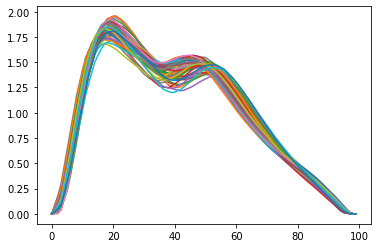

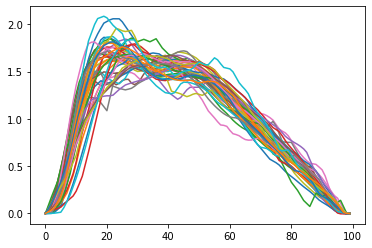

2.702073698334465


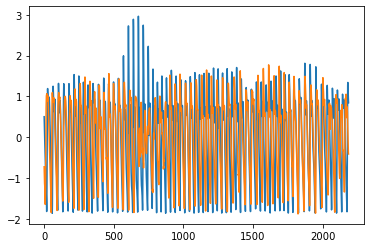

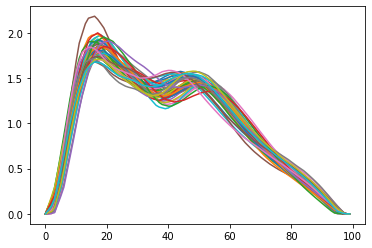

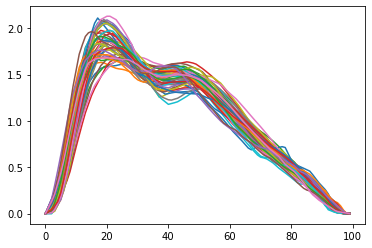

1.4291145482003451


In [52]:
nbplot('090facemesh5ch_normalizedlabel_testing',model,test_dataset,20,writef = True)

In [ ]:
th.save(model.state_dict(), "./saved_model/600Ver1_1lambda075.pth")